In [1]:
import sys, os
sys.path.insert(0, '/data1/home/rocks/discrete_elasticity_v2/')
sys.path.insert(0, '/data1/home/rocks/discrete_elasticity_v2/python_src/')

import numpy as np
import scipy as sp
import gzip
import cPickle as pickle
import matplotlib.pyplot as plt; plt.rcdefaults()
import seaborn as sns
%matplotlib inline

sns.set(color_codes=True)
sns.set_context('poster', font_scale=1.75)
sns.set_palette("hls", 8)
# sns.set_palette("muted", 8)
sns.set_style('ticks', {'xtick.direction': 'in','ytick.direction': 'in', 'axes.linewidth': 2.0})


import mech_network_solver as mns
import network
import tuning_algs as talgs
import network_plot as nplot
import nonlin_solver as nls

Loading Mechanical Network Deformation Solver Module


In [2]:
DIM = 2

# nw_label = "network_periodic_jammed/network_N{:05d}_Lp{:.2f}/network_irec{:04d}".format(64, -1.0, 2)

# with gzip.open("/data1/home/rocks/data/discrete_response/{:}.pklz".format(nw_label), 'rb') as pkl_file:

#     nw_data = pickle.load(pkl_file)
#     old_nw = nw_data['network']
    
# nw = network.Network(DIM, old_nw.NN, old_nw.node_pos, old_nw.NB, old_nw.bondi, old_nw.bondj, DIM, old_nw.L)
# nw.setStretchInt(old_nw.bvecij, old_nw.eq_length, np.ones(old_nw.NB, float) / old_nw.eq_length)

nw_label = "networks_spring_disc_3/db_N00008192_Lp-1.00/N00008192_Lp-1.00_radius0.04419417"
nw = network.loadFiniteRandomNetwork(nw_label, 123)
# 25

NF = 1

inodesi = [[] for t in range(NF)]
inodesj = [[] for t in range(NF)]

close =  network.chooseNodesAngle(nw, 180)

# close = network.closest_nodes(0.25*nw.L, nw)

inodesi[0].append(close[0])
inodesj[0].append(close[1])

isvec = [[] for t in range(NF)]
for t in range(NF):
    for (i, j) in zip(inodesi[t], inodesj[t]):
        posi = nw.node_pos[DIM*i:DIM*i+DIM]
        posj = nw.node_pos[DIM*j:DIM*j+DIM]
        bvec = posj - posi
        bvec -= np.round(bvec/nw.L)*nw.L
        isvec[t].extend(bvec) 
    
istrain = [[] for t in range(NF)]
istrain[0].append(0.5)


onodesi = [[] for t in range(NF)]
onodesj = [[] for t in range(NF)]

close =  network.chooseNodesAngle(nw, 0)
# close = network.closest_nodes(0.75*nw.L, nw)

onodesi[0].append(close[0])
onodesj[0].append(close[1])

# close =  network.chooseNodesAngle(nw, -60)
# # close = network.closest_nodes(0.50*nw.L, nw)

# onodesi[0].append(close[0])
# onodesj[0].append(close[1])


osvec = [[] for t in range(NF)]
for t in range(NF):
    for (i, j) in zip(onodesi[t], onodesj[t]):
        posi = nw.node_pos[DIM*i:DIM*i+DIM]
        posj = nw.node_pos[DIM*j:DIM*j+DIM]
        bvec = posj - posi
        bvec -= np.round(bvec/nw.L)*nw.L
        osvec[t].extend(bvec) 
    
ostrain = [[] for t in range(NF)]
ostrain[0].append(0.5)
# ostrain[0].append(-1.0)
    
pert = []
meas = []
for t in range(NF):
    pert.append(talgs.Perturb())
    pert[t].setInputStrain(len(inodesi[t]), inodesi[t], inodesj[t], istrain[t], isvec[t])

    meas.append(talgs.Measure())
    meas[t].setOutputStrain(len(onodesi[t]), onodesi[t], onodesj[t], osvec[t])

obj_func = mns.CyIneqRatioChangeObjFunc(len(np.concatenate(ostrain)), nw.NE, 
                                        np.zeros(len(np.concatenate(ostrain)), float), np.concatenate(ostrain))    

In [5]:
DIM = 2

# nw_label = "network_periodic_jammed/network_N{:05d}_Lp{:.2f}/network_irec{:04d}".format(64, -1.0, 2)

# with gzip.open("/data1/home/rocks/data/discrete_response/{:}.pklz".format(nw_label), 'rb') as pkl_file:

#     nw_data = pickle.load(pkl_file)
#     old_nw = nw_data['network']
    
# nw = network.Network(DIM, old_nw.NN, old_nw.node_pos, old_nw.NB, old_nw.bondi, old_nw.bondj, DIM, old_nw.L)
# nw.setStretchInt(old_nw.bvecij, old_nw.eq_length, np.ones(old_nw.NB, float) / old_nw.eq_length)

nw_label = "networks_spring_disc_3/db_N00008192_Lp-1.40/N00008192_Lp-1.40_radius0.08838835"
nw = network.loadFiniteRandomNetwork(nw_label, 123)
# 25

NF = 2

inodesi = [[] for t in range(NF)]
inodesj = [[] for t in range(NF)]

close =  network.chooseNodesAngle(nw, 180)

inodesi[0].append(close[0])
inodesj[0].append(close[1])


close =  network.chooseNodesAngle(nw, 270)

inodesi[1].append(close[0])
inodesj[1].append(close[1])

isvec = [[] for t in range(NF)]
for t in range(NF):
    for (i, j) in zip(inodesi[t], inodesj[t]):
        posi = nw.node_pos[DIM*i:DIM*i+DIM]
        posj = nw.node_pos[DIM*j:DIM*j+DIM]
        bvec = posj - posi
        bvec -= np.round(bvec/nw.L)*nw.L
        isvec[t].extend(bvec) 
    
istrain = [[] for t in range(NF)]
istrain[0].append(1.0)
istrain[1].append(1.0)

onodesi = [[] for t in range(NF)]
onodesj = [[] for t in range(NF)]

close =  network.chooseNodesAngle(nw, 0)

onodesi[0].append(close[0])
onodesj[0].append(close[1])

close =  network.chooseNodesAngle(nw, 90)

onodesi[1].append(close[0])
onodesj[1].append(close[1])


osvec = [[] for t in range(NF)]
for t in range(NF):
    for (i, j) in zip(onodesi[t], onodesj[t]):
        posi = nw.node_pos[DIM*i:DIM*i+DIM]
        posj = nw.node_pos[DIM*j:DIM*j+DIM]
        bvec = posj - posi
        bvec -= np.round(bvec/nw.L)*nw.L
        osvec[t].extend(bvec) 
    
ostrain = [[] for t in range(NF)]
ostrain[0].append(1.0)
ostrain[1].append(-1.0)

pert = []
meas = []
for t in range(NF):
    pert.append(talgs.Perturb())
    pert[t].setInputStrain(len(inodesi[t]), inodesi[t], inodesj[t], istrain[t], isvec[t])

    meas.append(talgs.Measure())
    meas[t].setOutputStrain(len(onodesi[t]), onodesi[t], onodesj[t], osvec[t])

obj_func = mns.CyIneqRatioChangeObjFunc(len(np.concatenate(ostrain)), nw.NE, 
                                        np.zeros(len(np.concatenate(ostrain)), float), np.concatenate(ostrain))    

In [22]:
DIM = 3

# nw_label = "networks_spring_ball_3/db_N00004096_Lp-1.00/N00004096_Lp-1.00_radius0.12500000"
nw_label = "networks_spring_ball_3/db_N00004096_Lp-1.00/N00004096_Lp-1.00_radius0.14865089"

nw = network.loadFiniteRandomNetwork(nw_label, 123)
# 25

NF = 1

inodesi = [[] for t in range(NF)]
inodesj = [[] for t in range(NF)]

close =  network.chooseNodesAngle(nw, 90, 0)

# close = network.closest_nodes(0.25*nw.L, nw)

inodesi[0].append(close[0])
inodesj[0].append(close[1])

isvec = [[] for t in range(NF)]
for t in range(NF):
    for (i, j) in zip(inodesi[t], inodesj[t]):
        posi = nw.node_pos[DIM*i:DIM*i+DIM]
        posj = nw.node_pos[DIM*j:DIM*j+DIM]
        bvec = posj - posi
        bvec -= np.round(bvec/nw.L)*nw.L
        isvec[t].extend(bvec) 
    
istrain = [[] for t in range(NF)]
istrain[0].append(0.25)


onodesi = [[] for t in range(NF)]
onodesj = [[] for t in range(NF)]

close =  network.chooseNodesAngle(nw, -90, 0)
# close = network.closest_nodes(0.75*nw.L, nw)

onodesi[0].append(close[0])
onodesj[0].append(close[1])

# close =  network.chooseNodesAngle(nw, -60)
# # close = network.closest_nodes(0.50*nw.L, nw)

# onodesi[0].append(close[0])
# onodesj[0].append(close[1])


osvec = [[] for t in range(NF)]
for t in range(NF):
    for (i, j) in zip(onodesi[t], onodesj[t]):
        posi = nw.node_pos[DIM*i:DIM*i+DIM]
        posj = nw.node_pos[DIM*j:DIM*j+DIM]
        bvec = posj - posi
        bvec -= np.round(bvec/nw.L)*nw.L
        osvec[t].extend(bvec) 
    
ostrain = [[] for t in range(NF)]
ostrain[0].append(0.25)
# ostrain[0].append(-1.0)
    
pert = []
meas = []
for t in range(NF):
    pert.append(talgs.Perturb())
    pert[t].setInputStrain(len(inodesi[t]), inodesi[t], inodesj[t], istrain[t], isvec[t])

    meas.append(talgs.Measure())
    meas[t].setOutputStrain(len(onodesi[t]), onodesi[t], onodesj[t], osvec[t])

obj_func = mns.CyIneqRatioChangeObjFunc(len(np.concatenate(ostrain)), nw.NE, 
                                        np.zeros(len(np.concatenate(ostrain)), float), np.concatenate(ostrain))  

print nw.NN, nw.NE

57 194


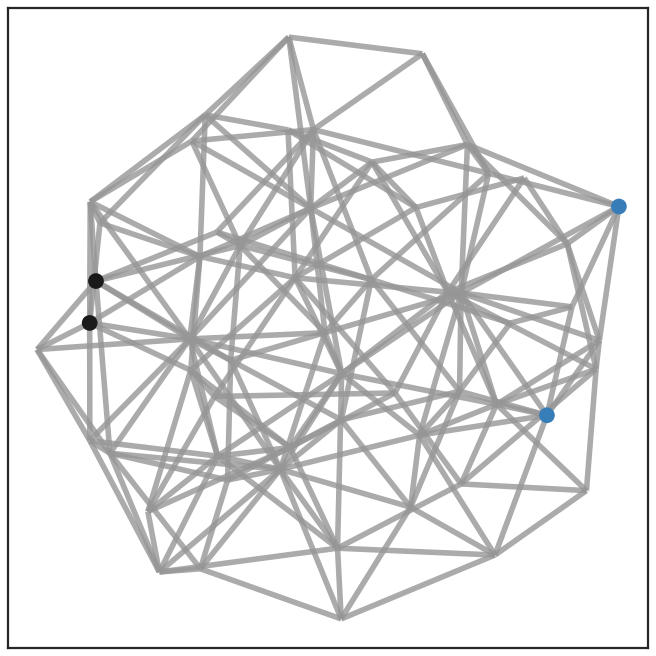

In [23]:
for t in range(NF):
    nplot.frame(nw, np.zeros(DIM*nw.NN, float), np.zeros([DIM, DIM], float), np.ones(nw.NE), 
            pert[t], meas[t], "", boxsize=0.5, padding=0.05, save=False)

In [24]:
K_init = np.ones(nw.NE, float) / nw.eq_length

# tuner = talgs.TuneContLin(nw, [pert], [meas], obj_func, K_init)
# tuner = talgs.TuneDiscLin(nw, pert, meas, obj_func, K_init)
tuner = talgs.TuneDiscNonlin(nw, pert, meas, obj_func, K_init)

result = tuner.tune()

Initial objective function: 0.5
0
Removing bond 7 would create zero mode. Skipping...
Removing bond 8 would create zero mode. Skipping...
Removing bond 9 would create zero mode. Skipping...
Removing bond 10 would create zero mode. Skipping...
Removing bond 11 would create zero mode. Skipping...
Removing bond 12 would create zero mode. Skipping...
Removing bond 13 would create zero mode. Skipping...
25
50
75
Removing bond 75 would create zero mode. Skipping...
Removing bond 91 would create zero mode. Skipping...
100
125
150
175
Objective function: 0.480493071792 Change: 0.0195069282083
Removing 1
0
Removing bond 7 would create zero mode. Skipping...
Removing bond 8 would create zero mode. Skipping...
Removing bond 9 would create zero mode. Skipping...
Removing bond 10 would create zero mode. Skipping...
Removing bond 11 would create zero mode. Skipping...
Removing bond 12 would create zero mode. Skipping...
Removing bond 13 would create zero mode. Skipping...
25
50
75
Removing bond 75 w

[ 1.15614669  1.18472216  1.06139122  1.19914553  1.06778672  1.06541372
  1.03538888  1.0561686   1.1329575   1.21290027  1.05298356  1.09873722
  1.05321094  1.05289979  1.06365335  1.17906711  1.12453724  1.05331552
  1.13849141  1.02182527  1.14351466  1.17715212  1.12671755  1.05699657
  1.13505754  1.04653264  1.12109811  1.1368302   1.13265488  1.02144563
  1.12196696  1.04588595  1.18836074  1.10104822  1.07963382  1.16340872
  1.051842    1.11114279  1.07480946  1.06858855  1.08799716  1.05482538
  1.18840721  1.05060588  1.12908707  1.088788    1.04405822  1.04623157
  1.18259497  1.05809646  1.16162974  1.09933753  1.07565905  1.04941712
  1.13460656  1.04979574  0.99284046  1.06699404  1.00365657  1.11565754
  1.16958272  1.11046971  1.01677357  1.15034139  1.02704907  1.11202139
  1.09356143  1.00411636  1.07171095  1.1029631   1.10647624  1.12158026
  1.02107427  1.10073313  1.08043005  1.10615275  1.12787049  1.10172939
  1.04464184  1.09231103  1.07063935  1.02447778  1

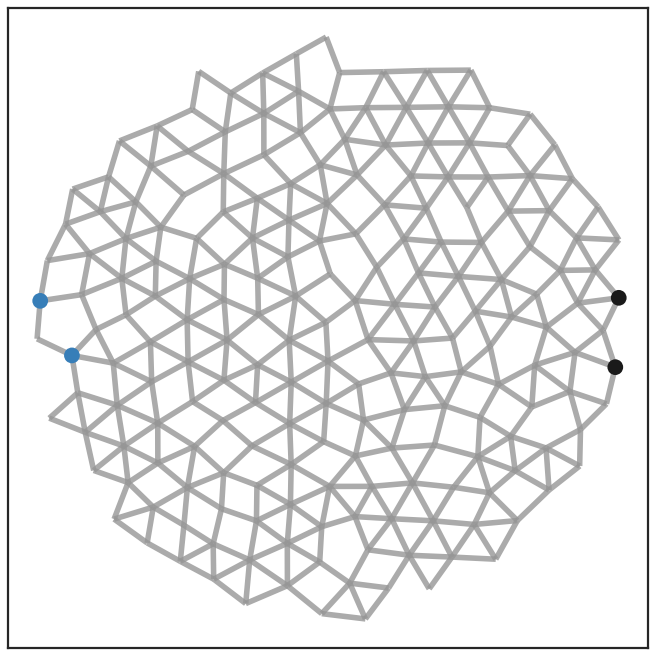

1


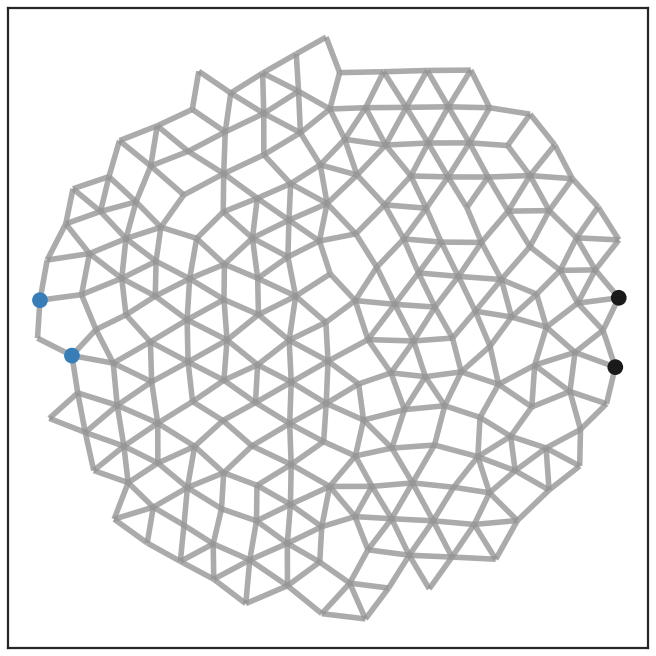

2


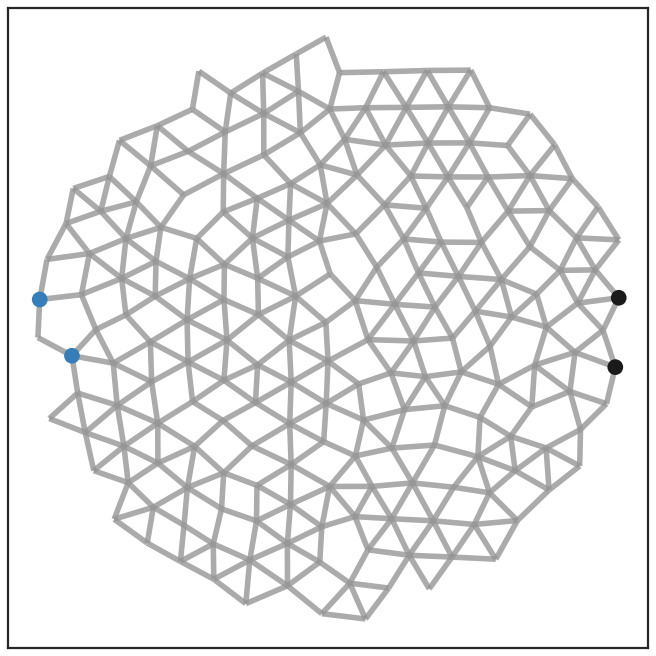

3


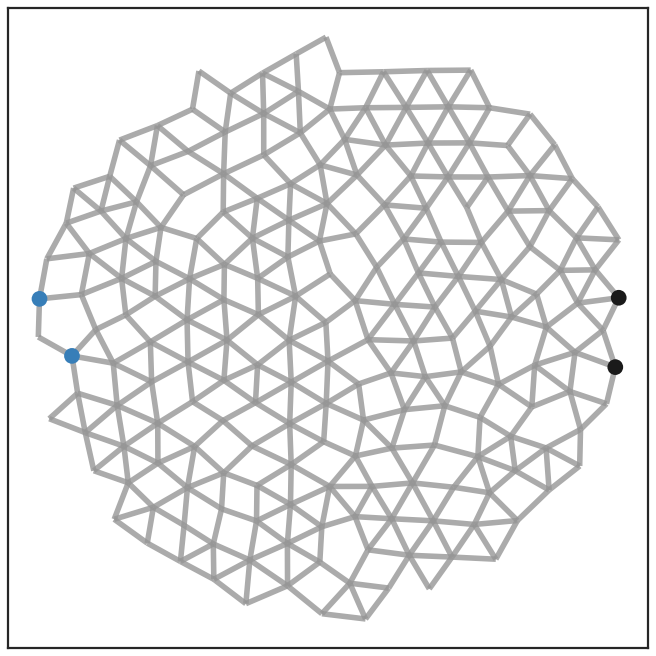

4


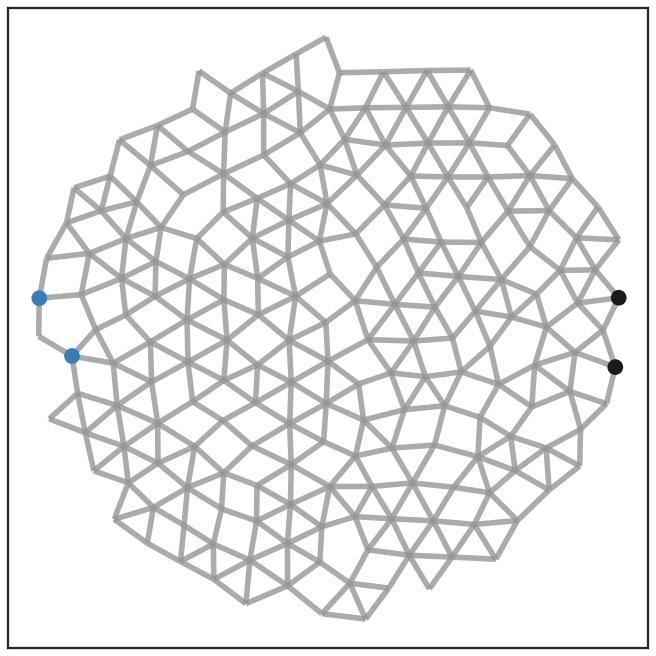

5


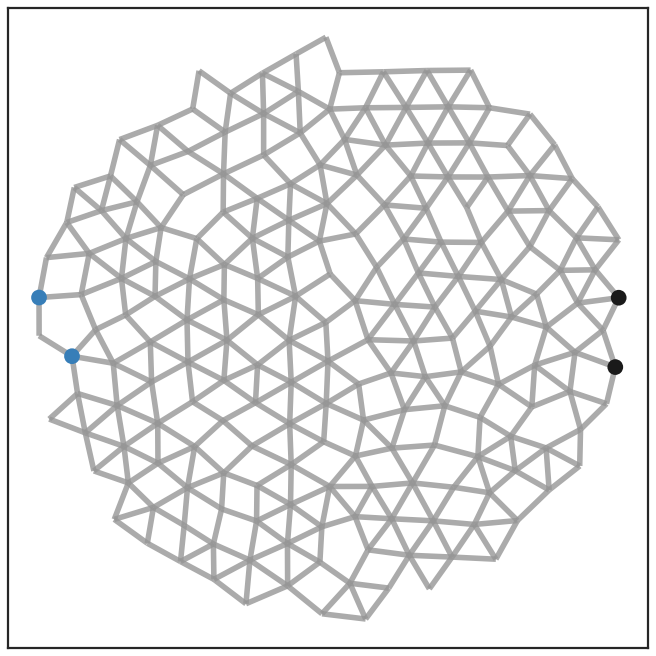

6


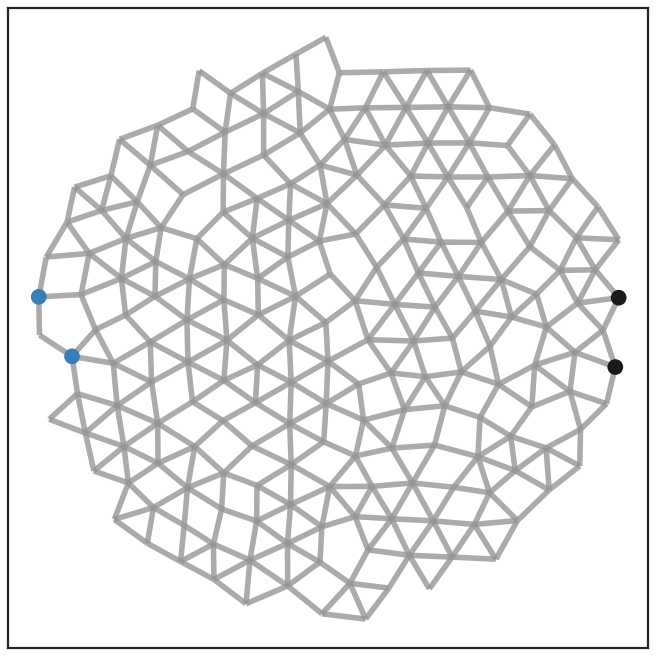

7


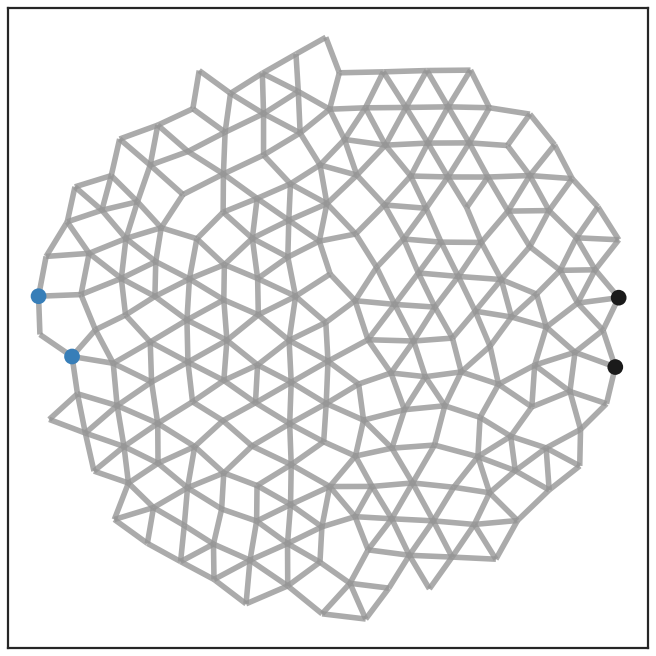

8


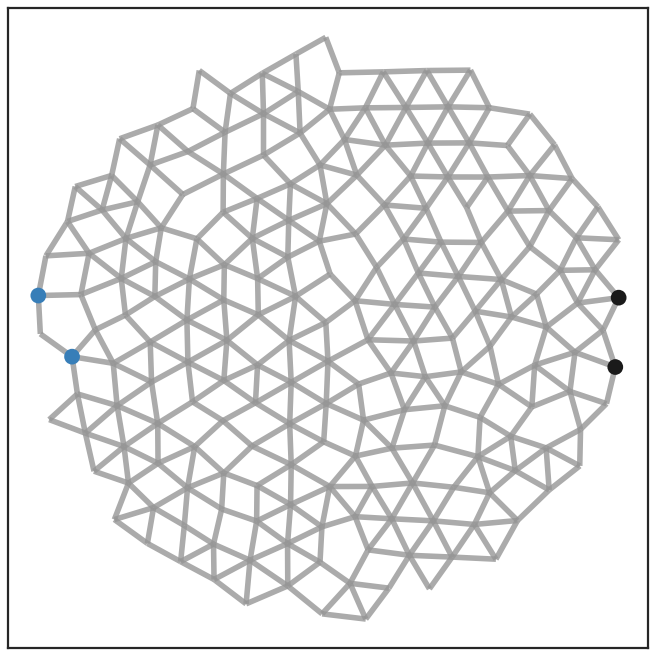

9


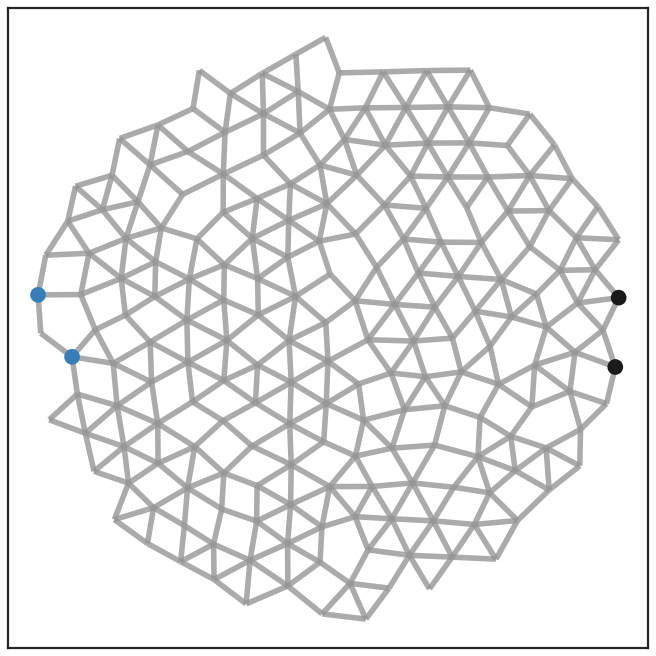

10


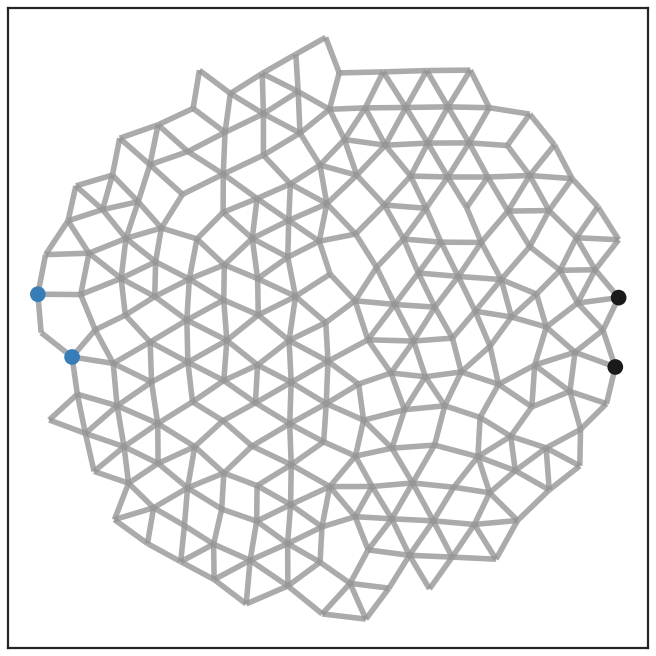

11


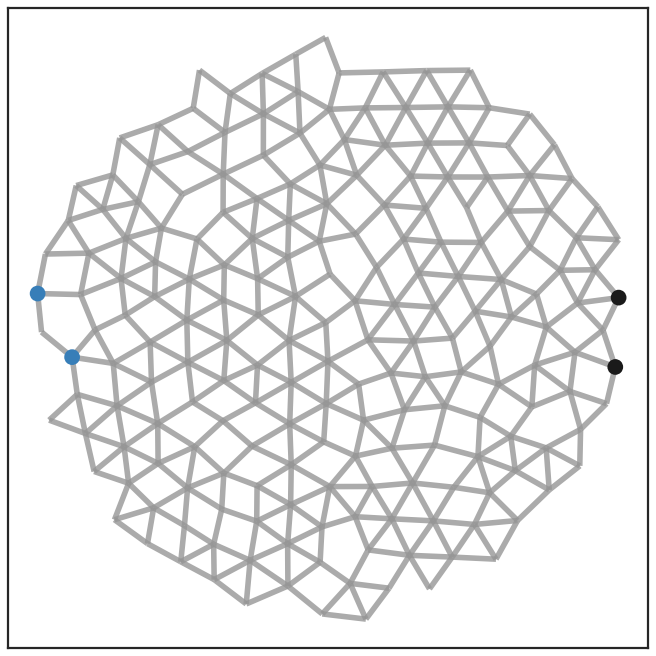

12


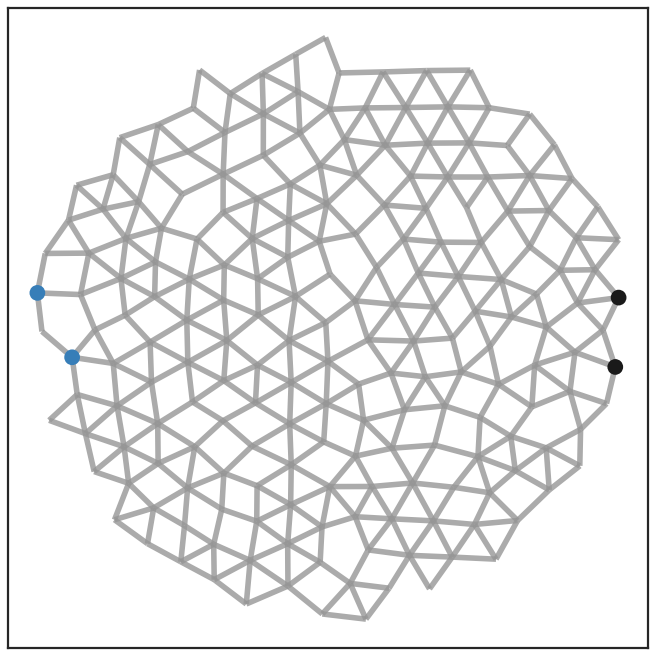

13


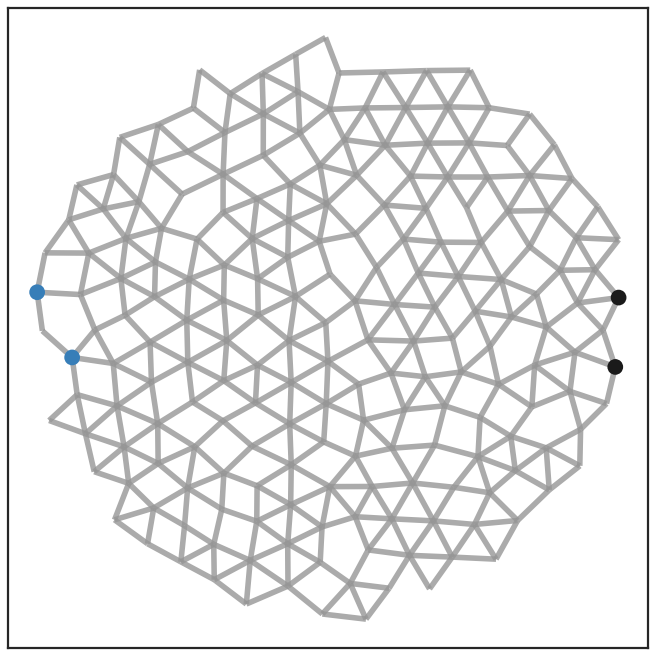

14


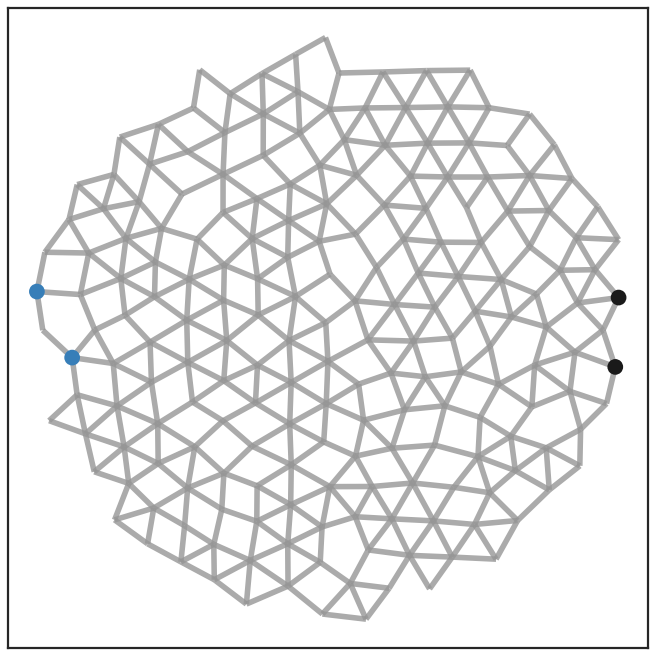

15


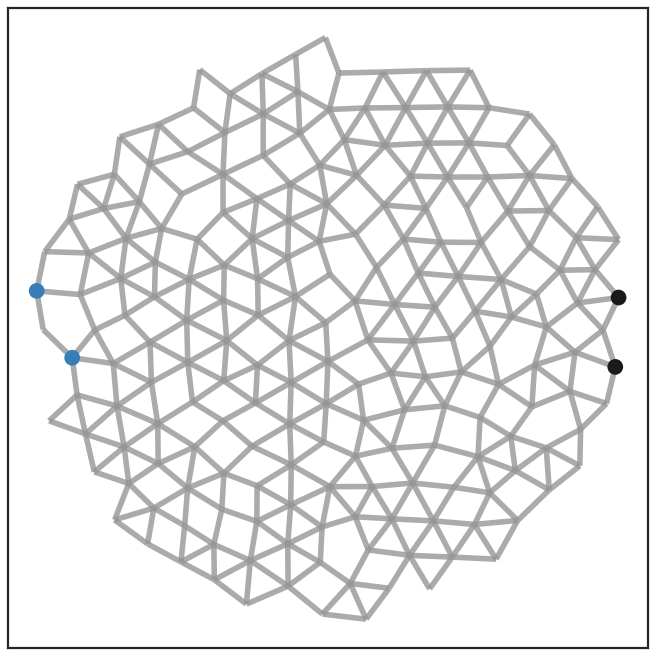

16


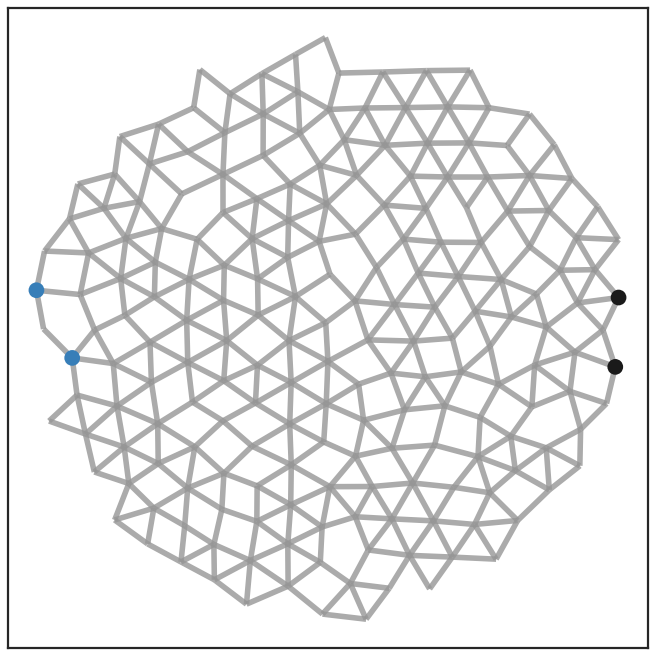

17


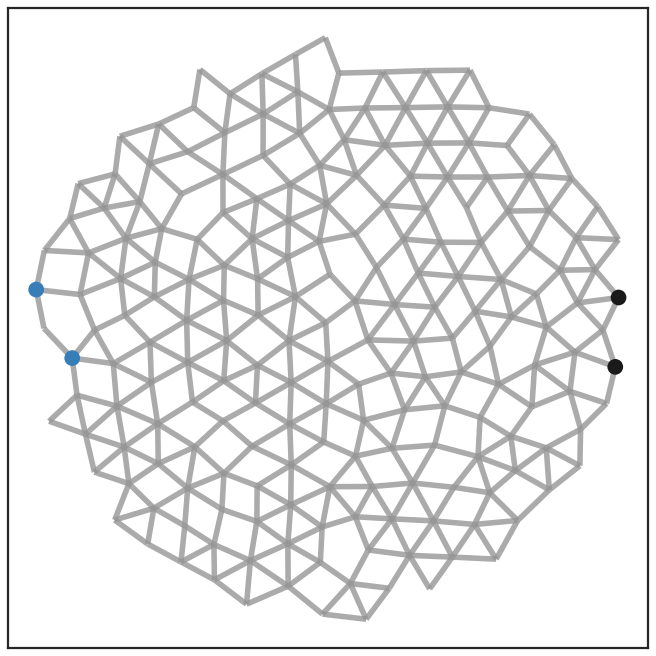

18


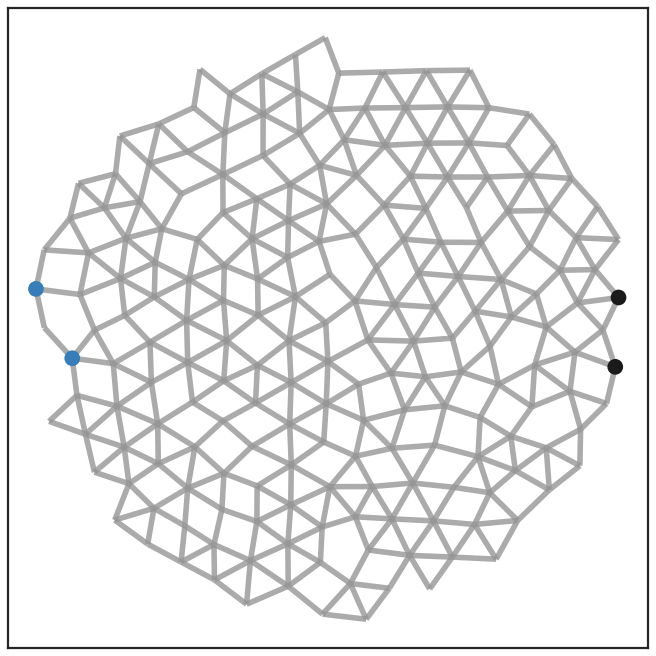

19


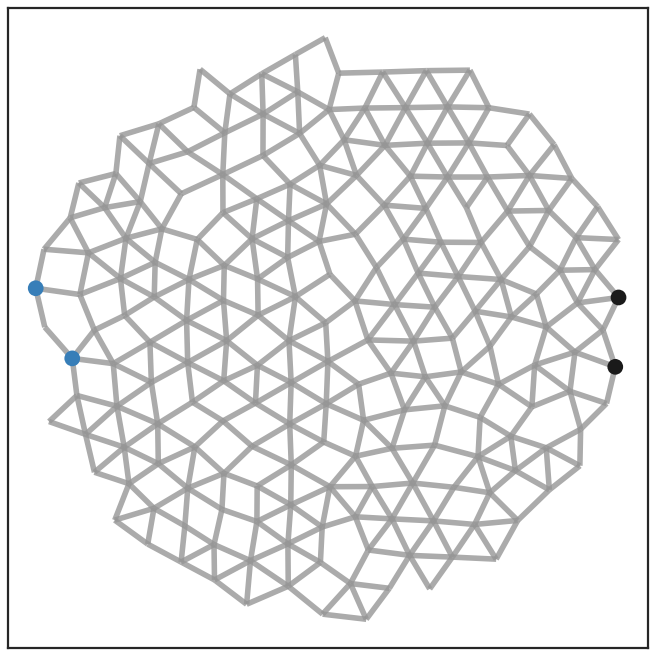

20


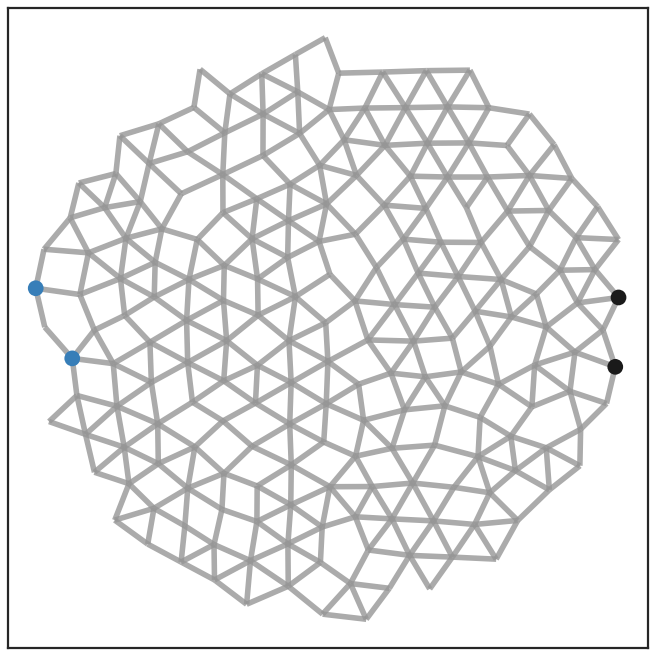

21


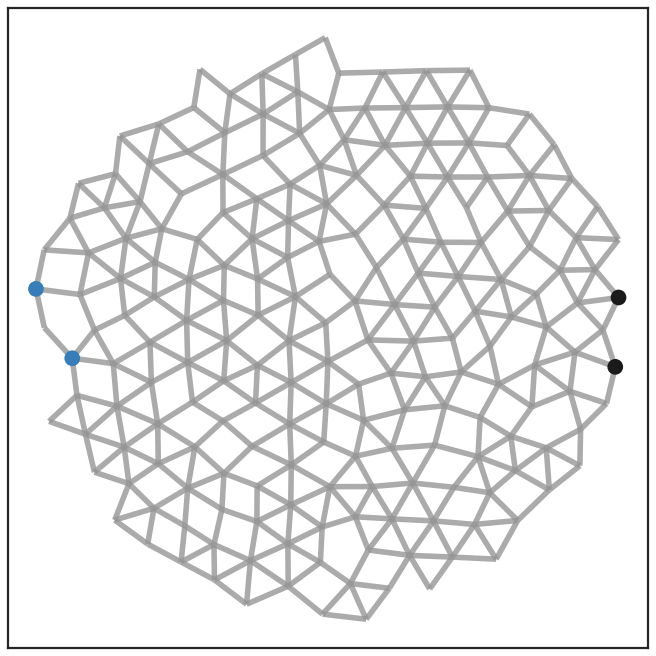

22


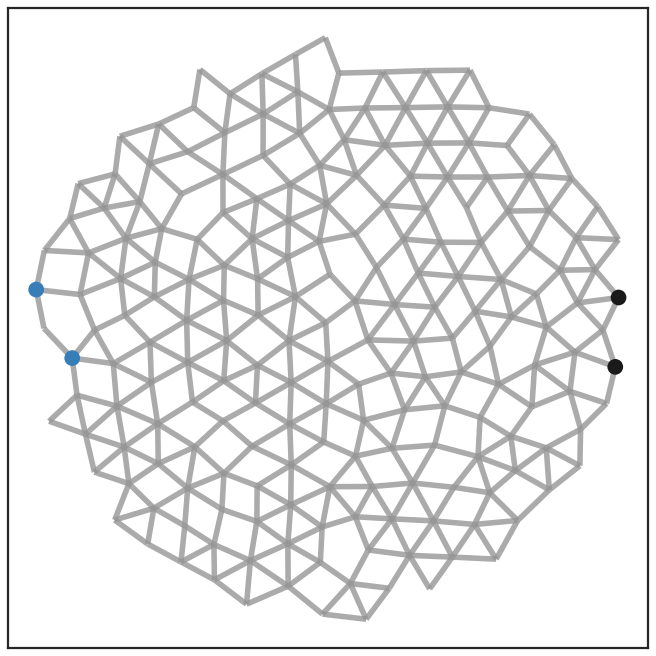

23


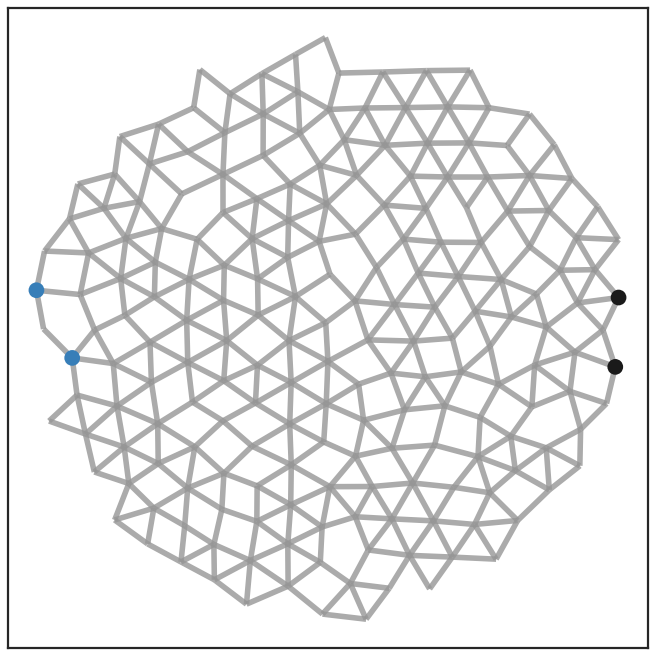

24


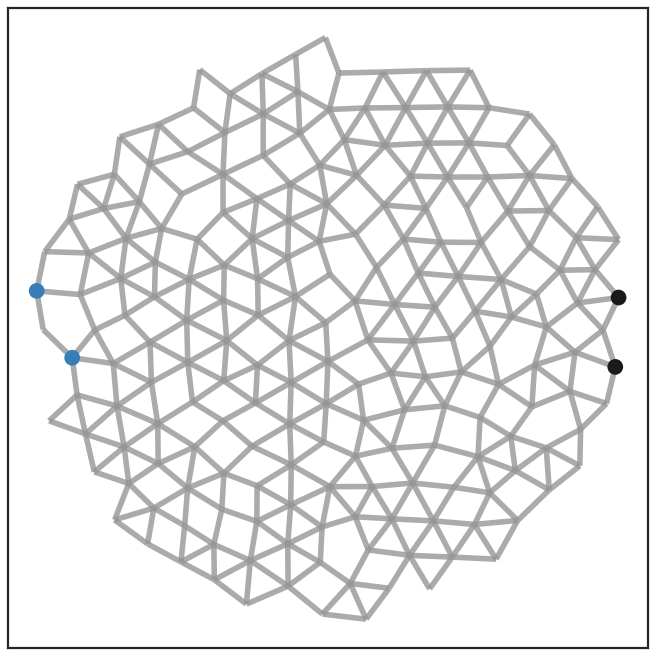

25


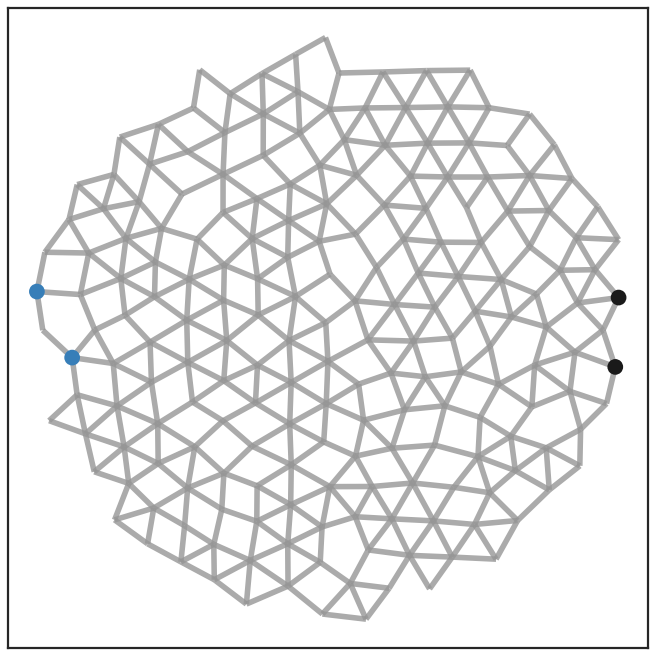

26


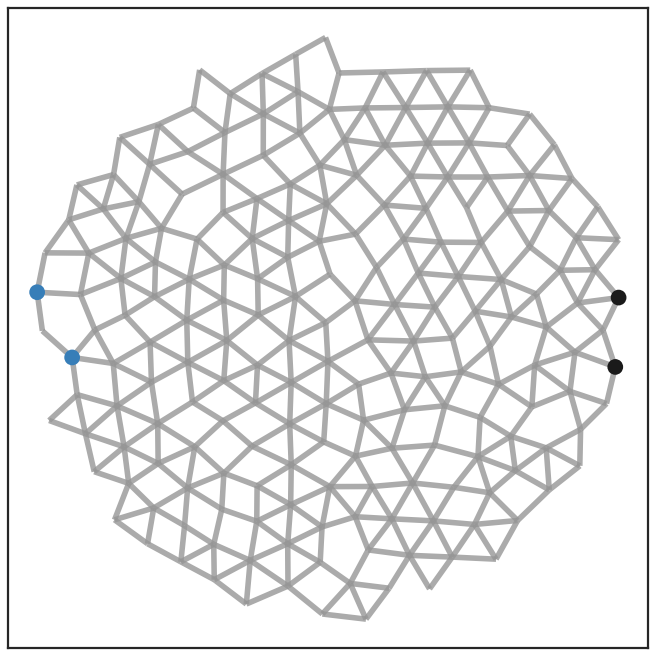

27


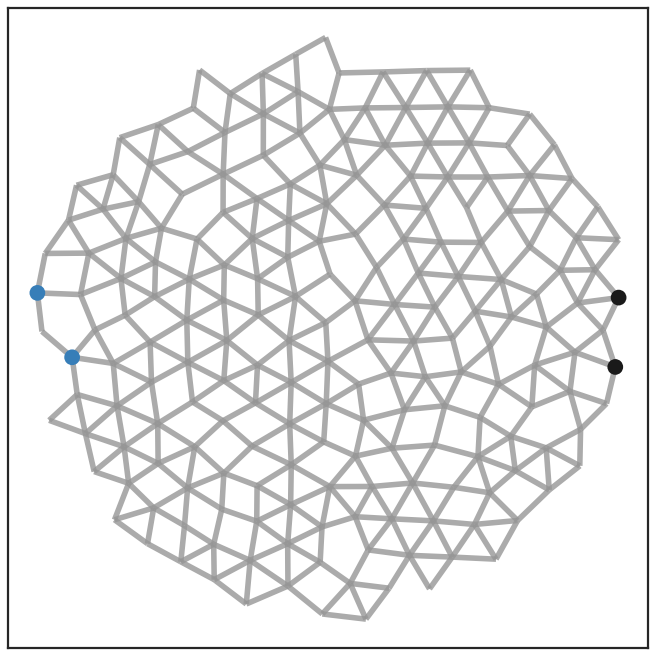

28


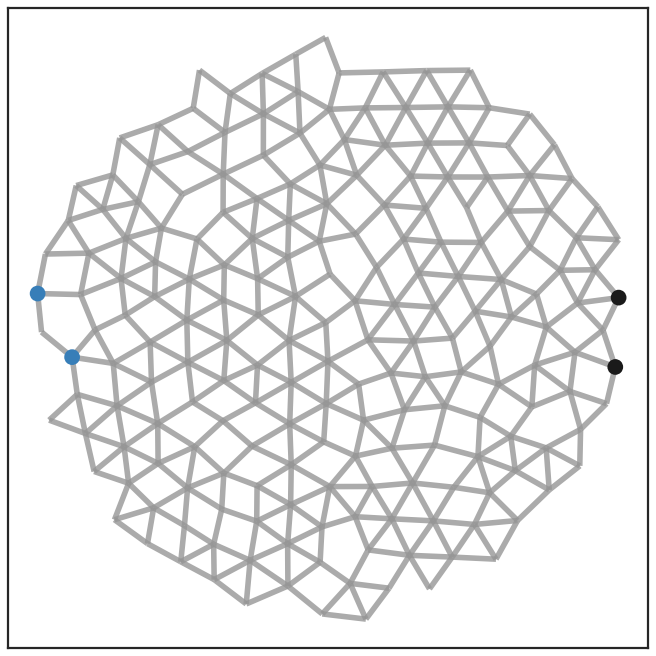

29


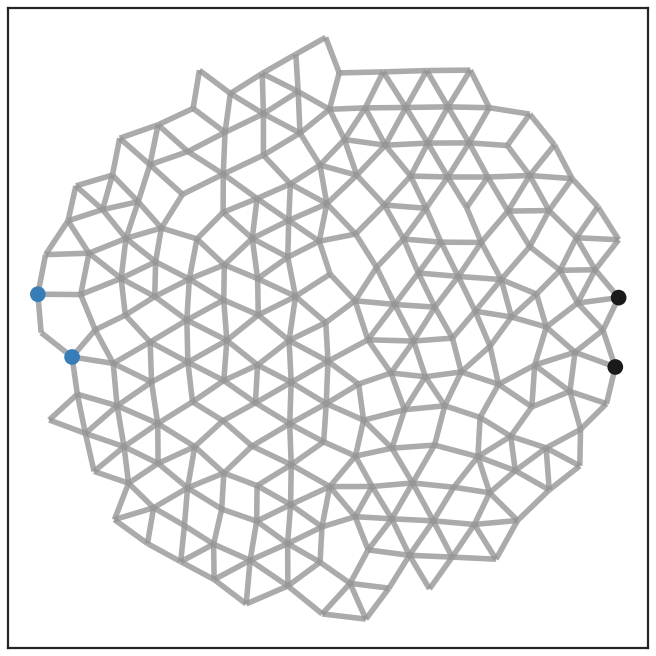

30


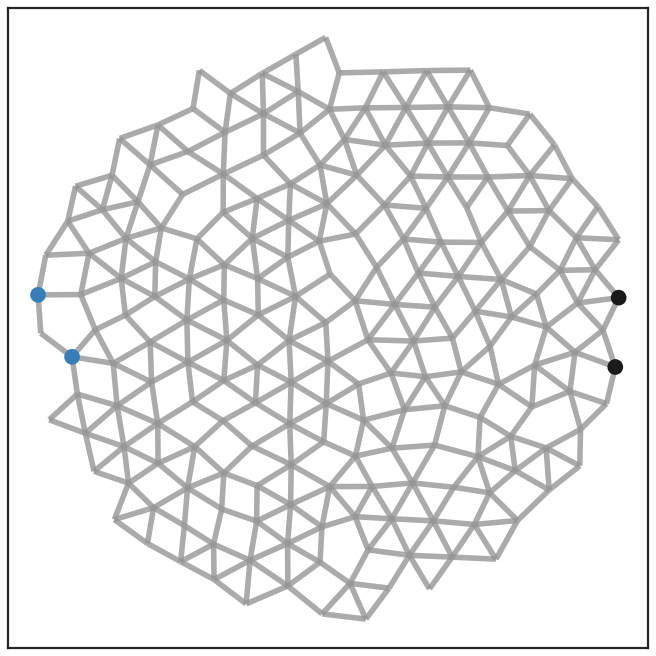

31


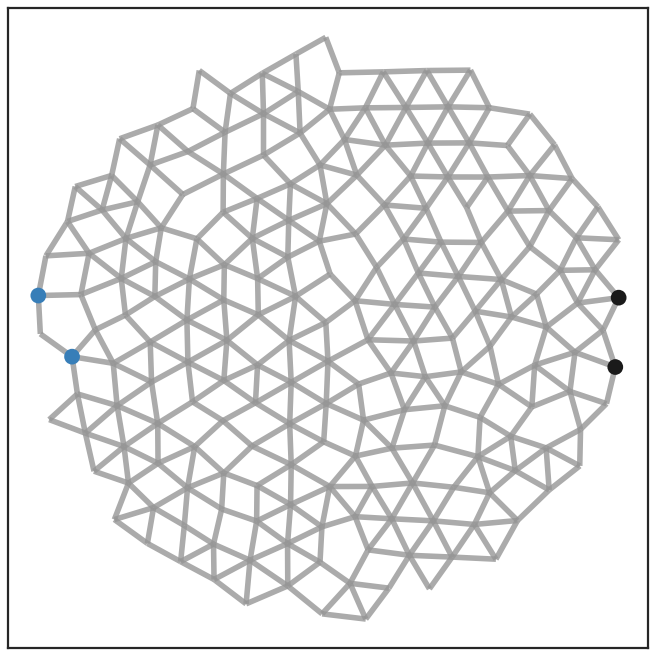

32


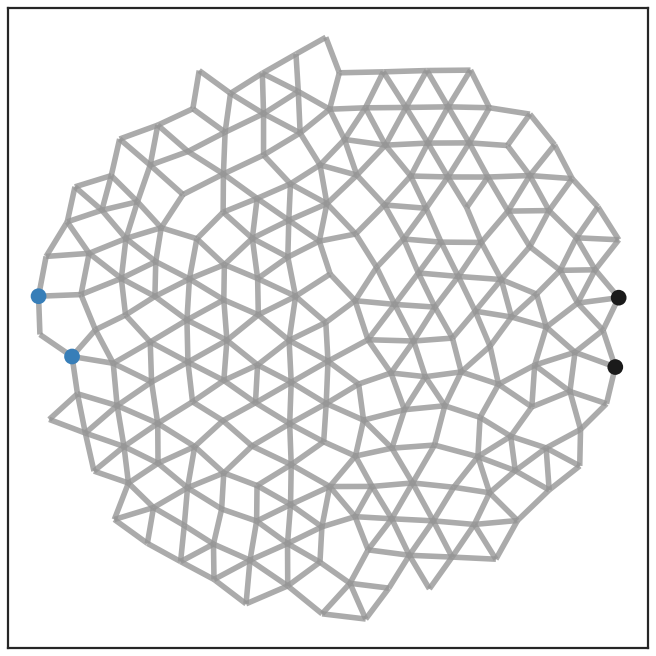

33


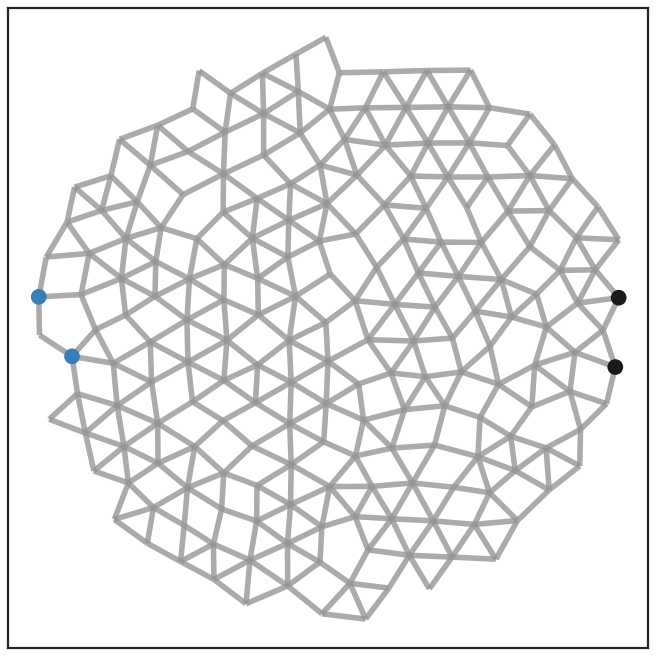

34


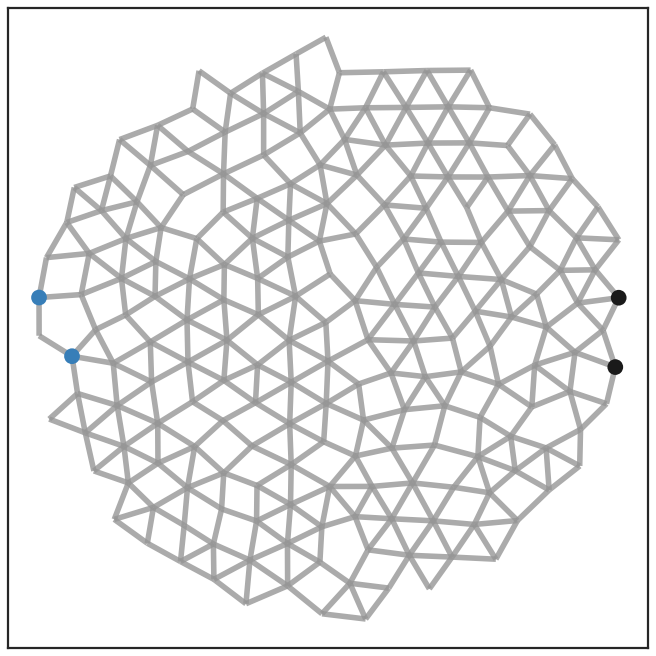

35


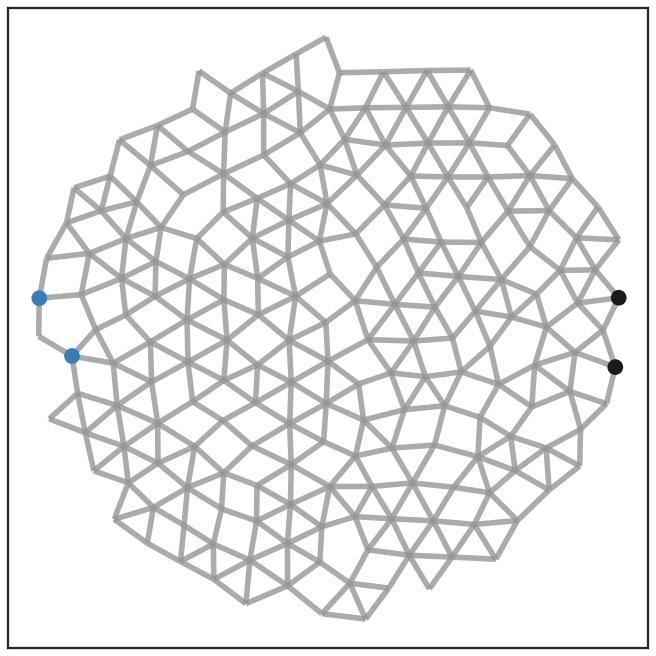

36


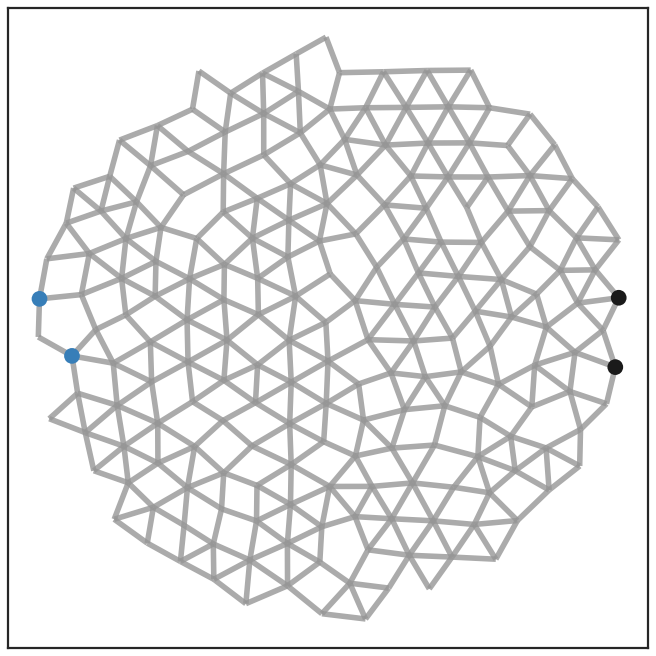

37


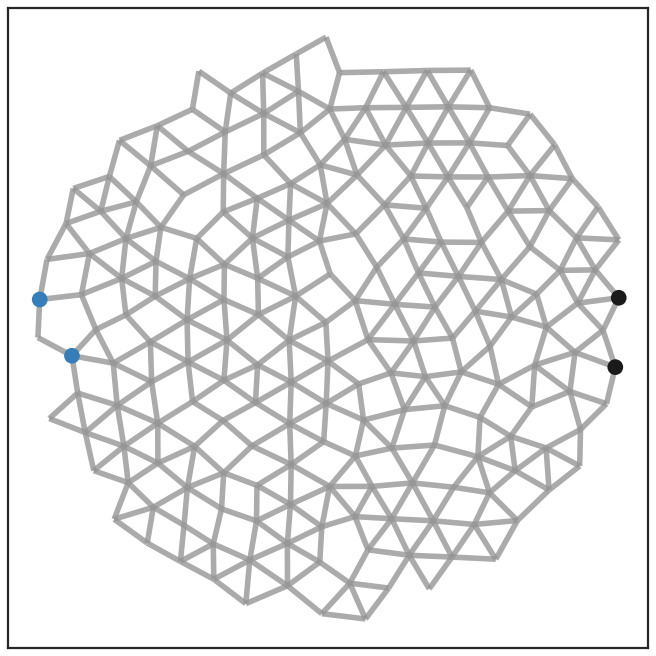

38


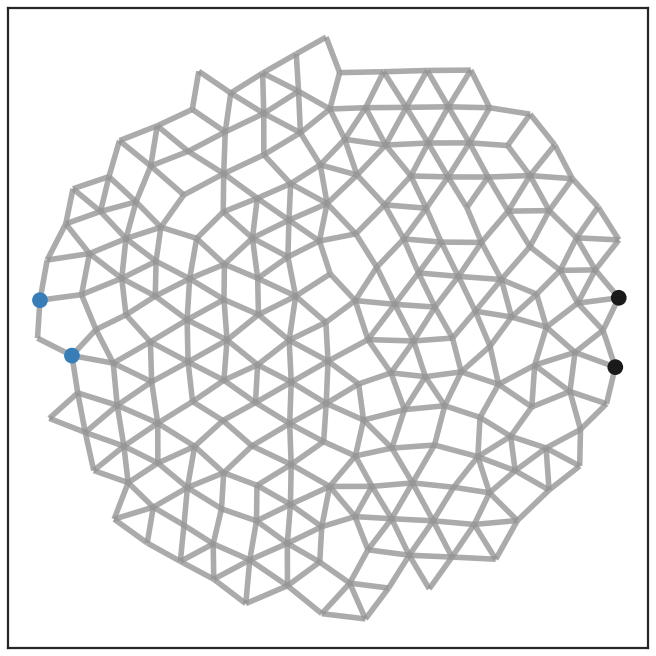

39


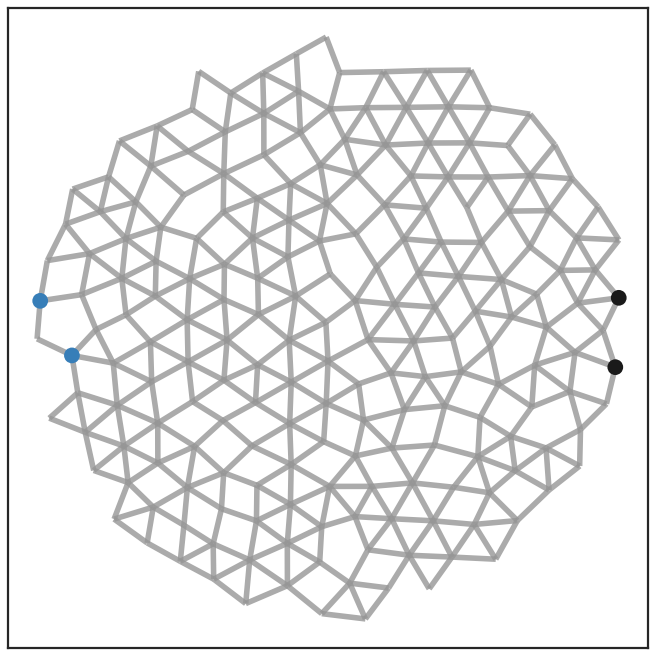

In [7]:
# K = result['K']
K = K_init

tuner.solver.setIntStrengths(K)
(disp, strain_tensor) = tuner.solver.solveDOF()

t = 0

# mag = 0.3
mag = 0.40
nsteps = 20
alpha_list = np.concatenate([np.linspace(0, mag, nsteps), np.linspace(mag, 0, nsteps)])

Gamma = np.array([[0.0, 0.0], [0.0, 0.0]])
# Gamma = np.array([[1.0, 0.0], [0.0, 1.0]])

os.system("rm figs/fig*.png")

for i, alpha in enumerate(alpha_list):
    print i
        
    nplot.frame(nw, alpha*disp[t], alpha*Gamma, K * nw.eq_length, pert[t], meas[t],
          "figs/fig_{:04d}.png".format(i), boxsize=0.5, padding=0.05, save=True, show_removed=True)

0


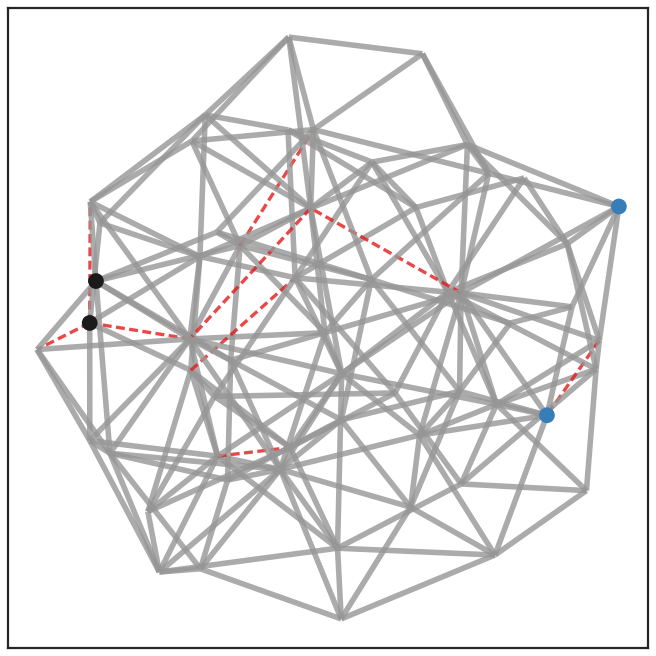

1


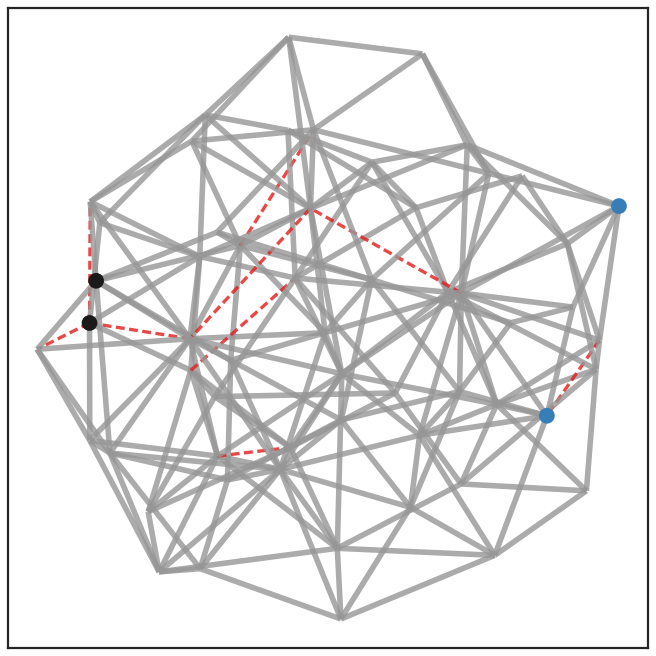

2


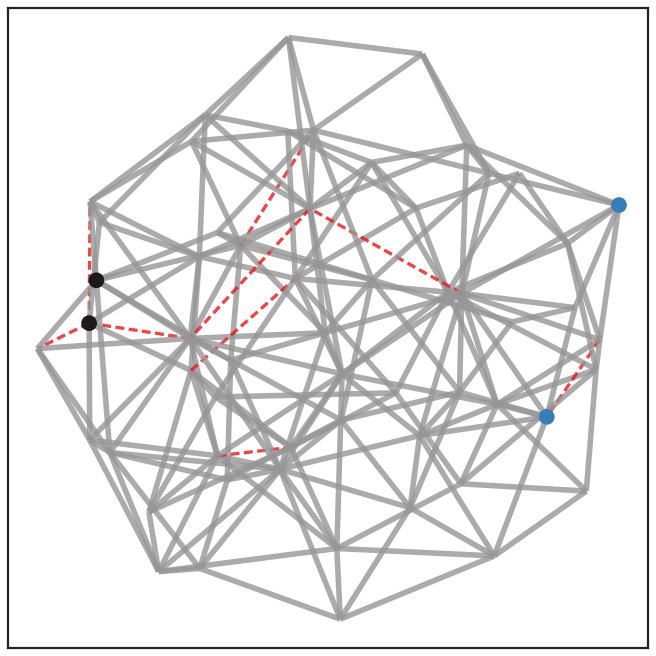

3


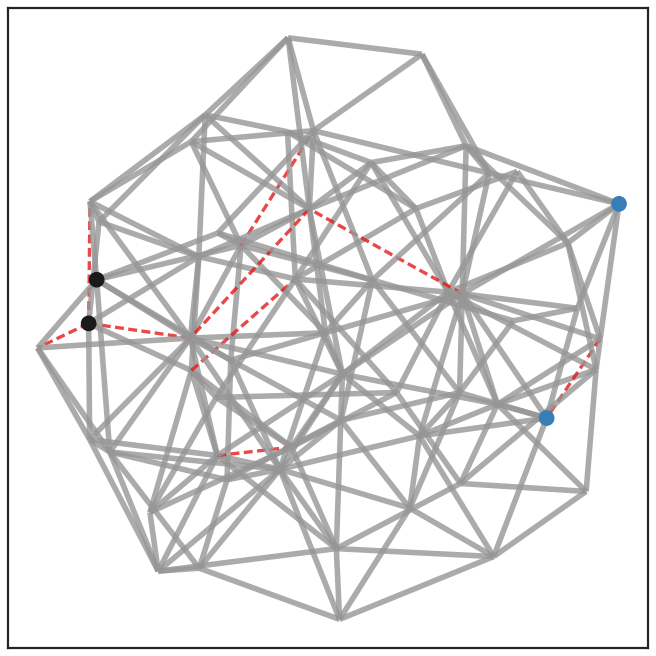

4


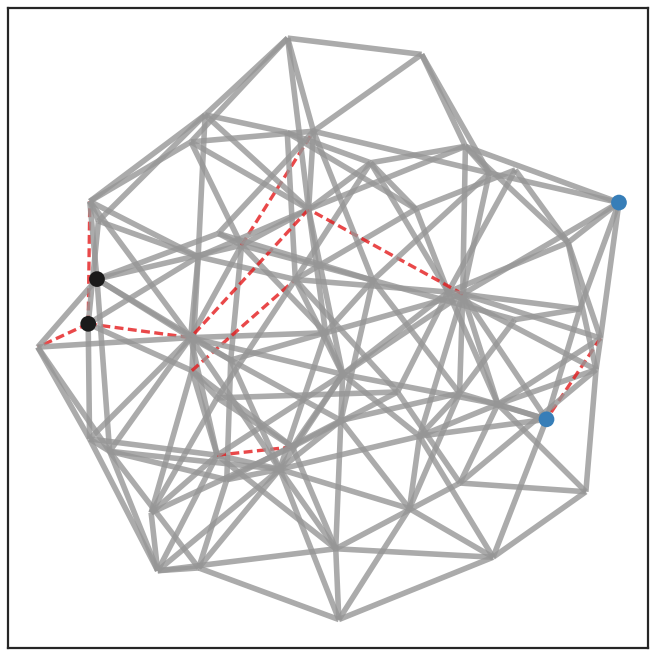

5


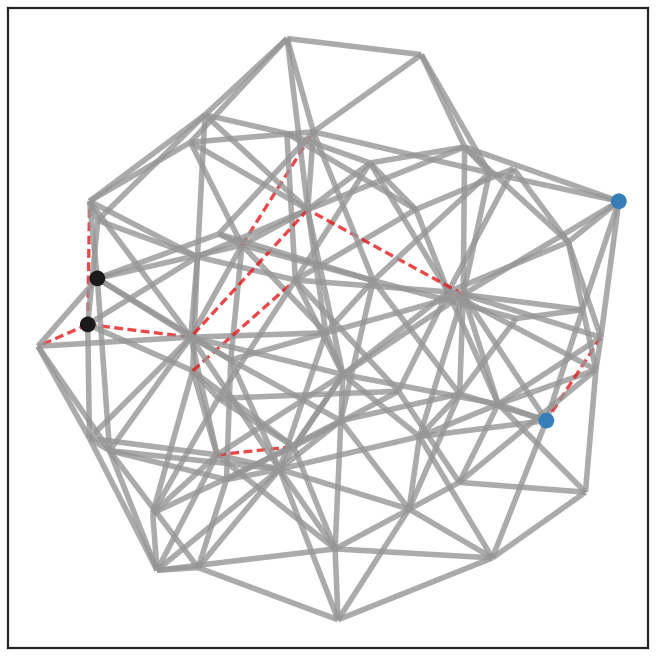

6


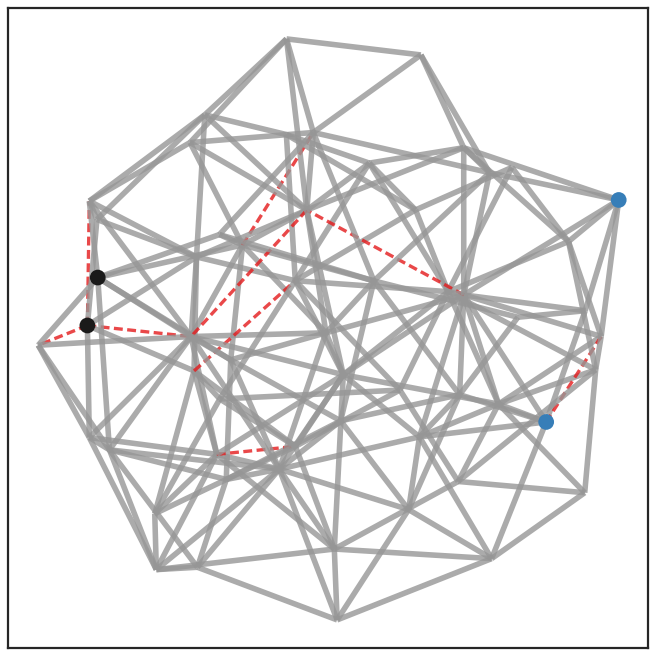

7


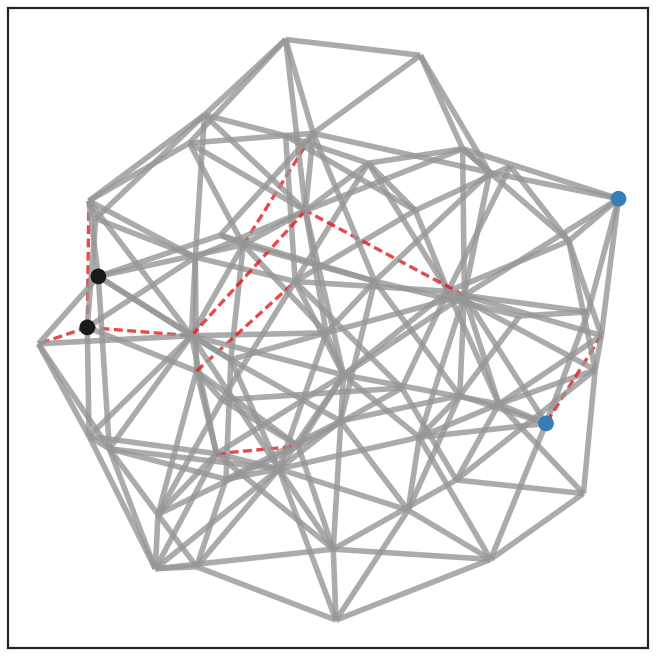

8


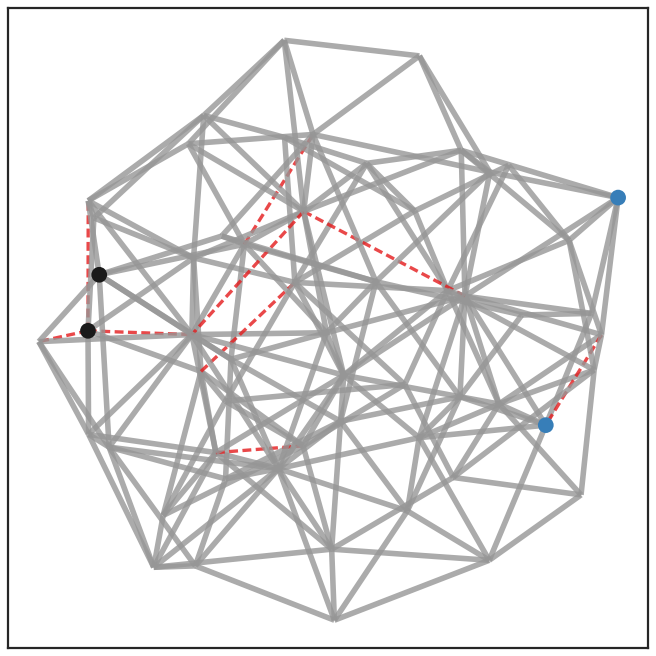

9


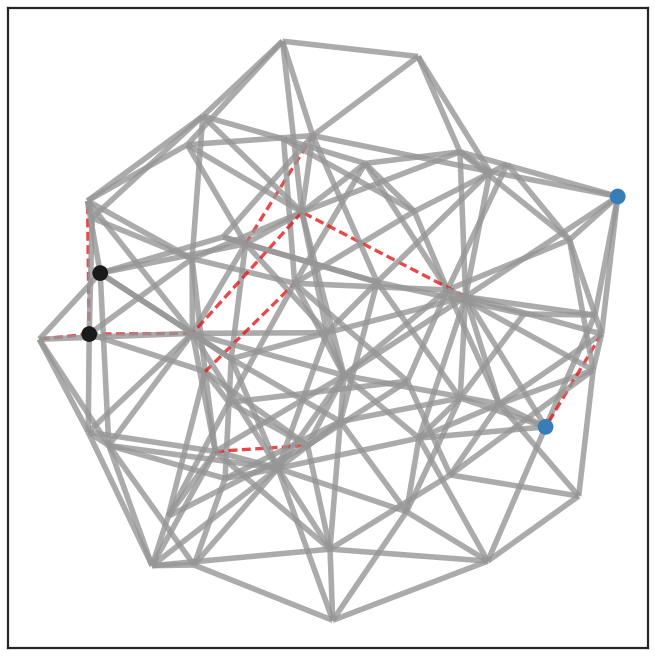

10


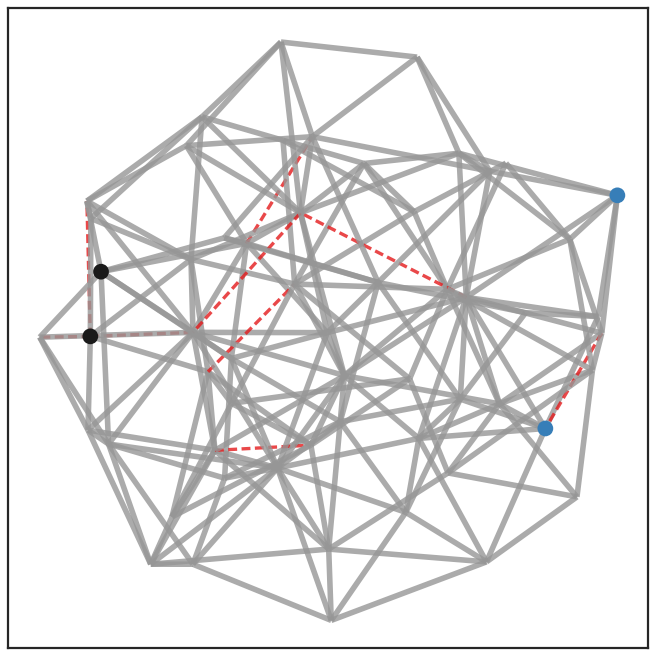

11


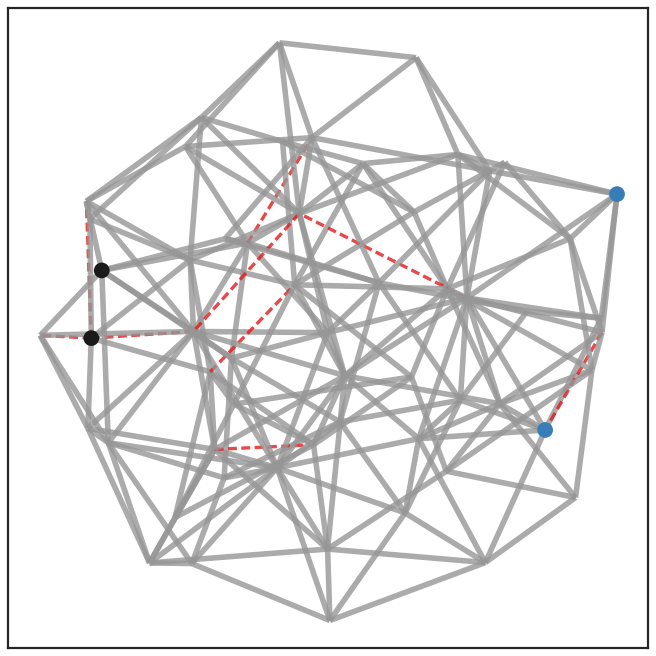

12


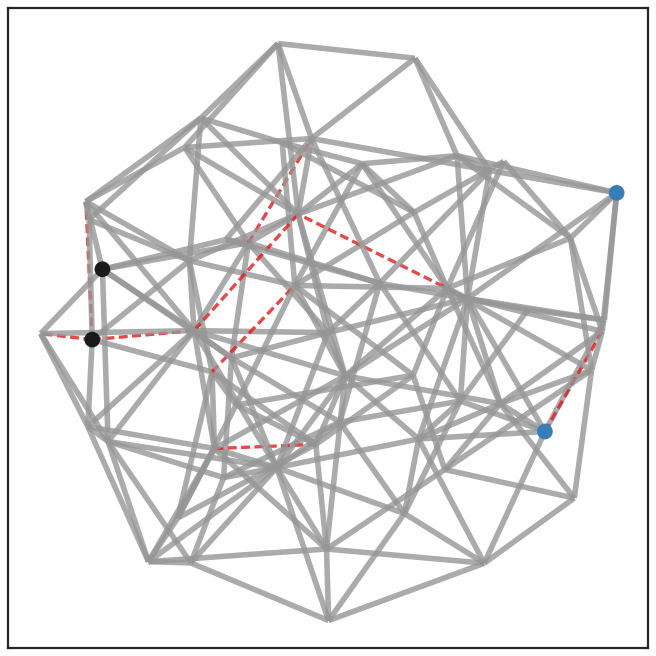

13


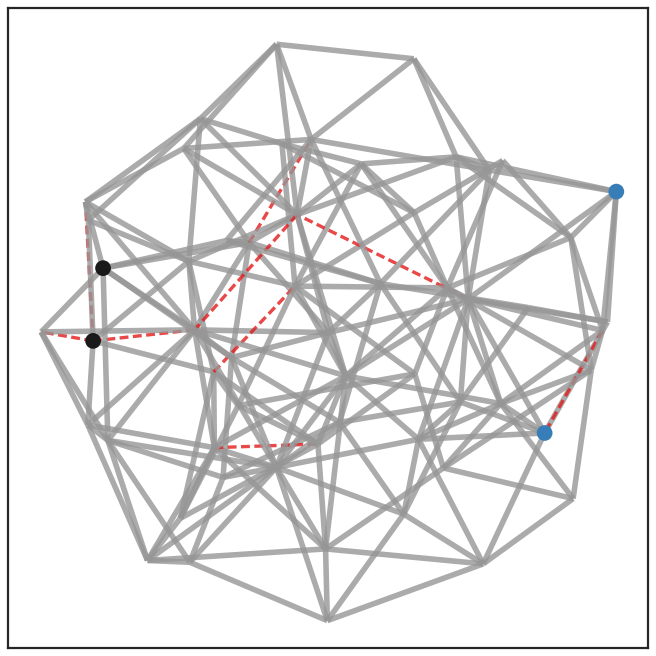

14


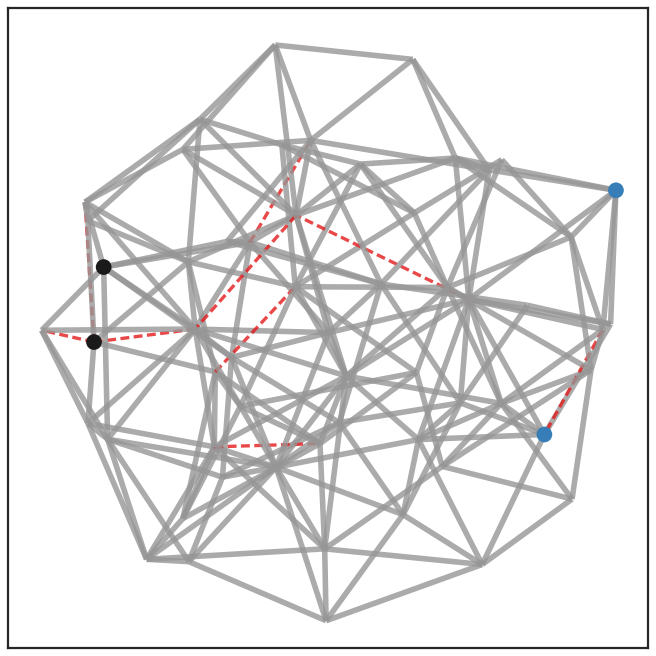

15


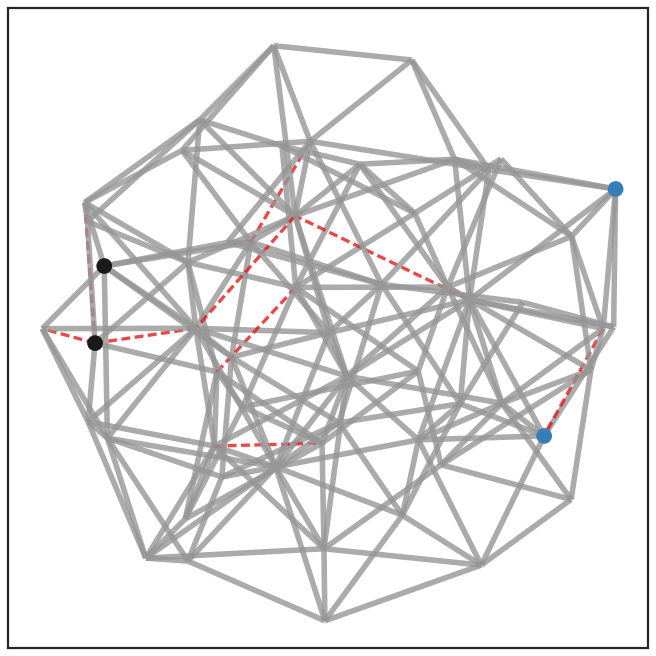

16


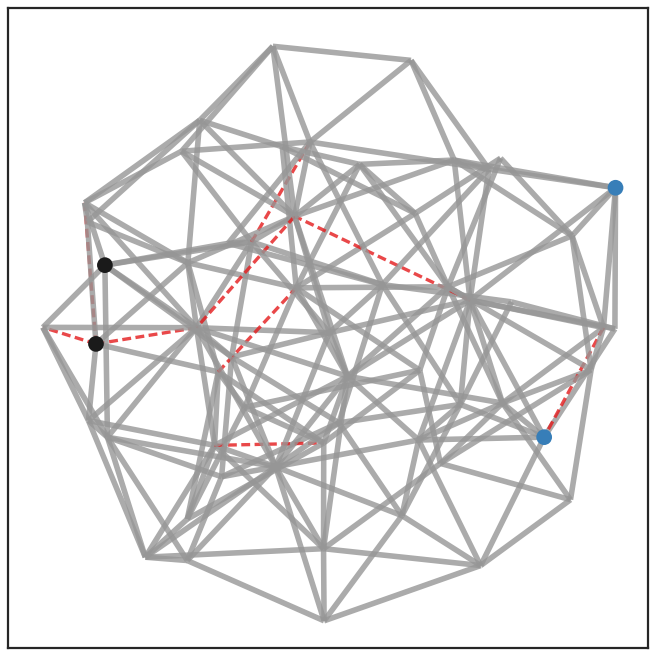

17


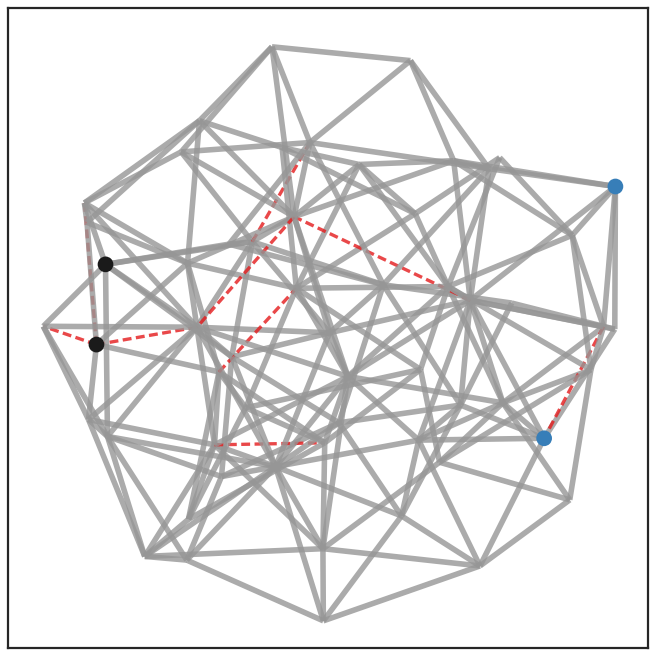

18


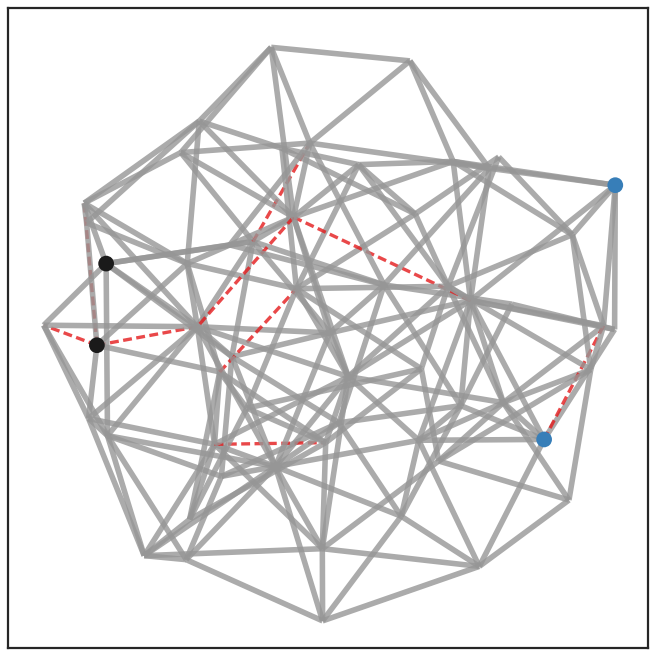

19


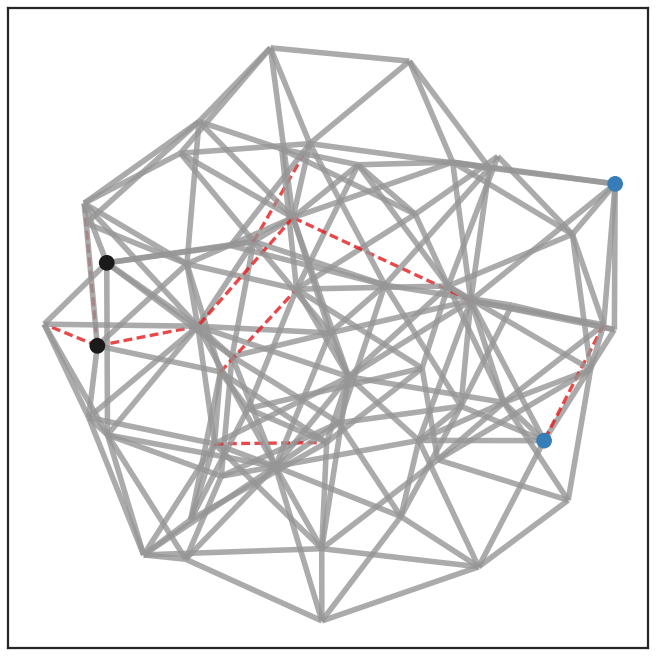

20


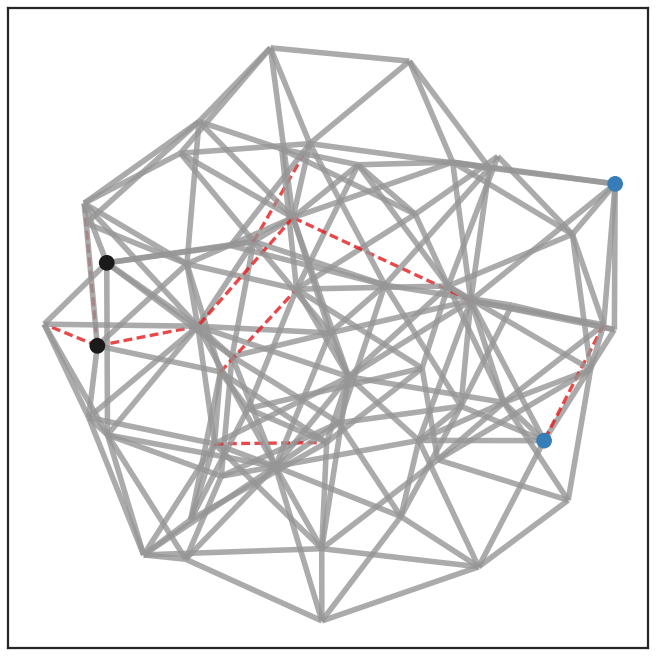

21


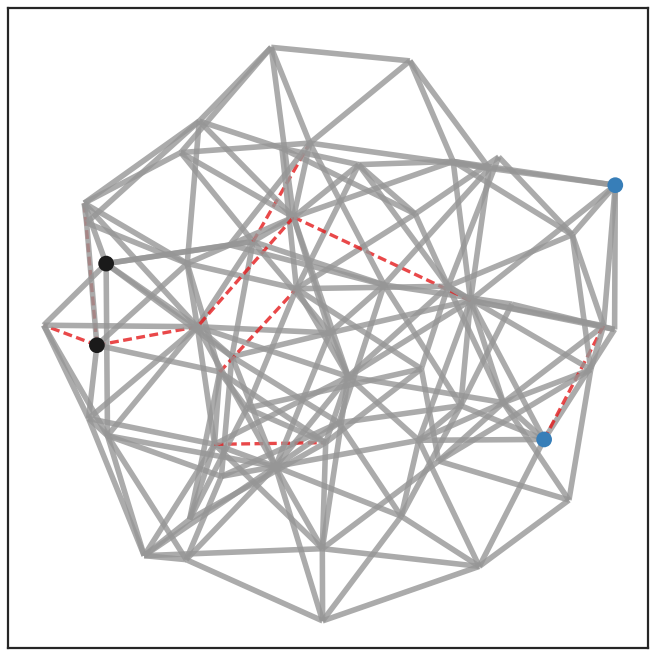

22


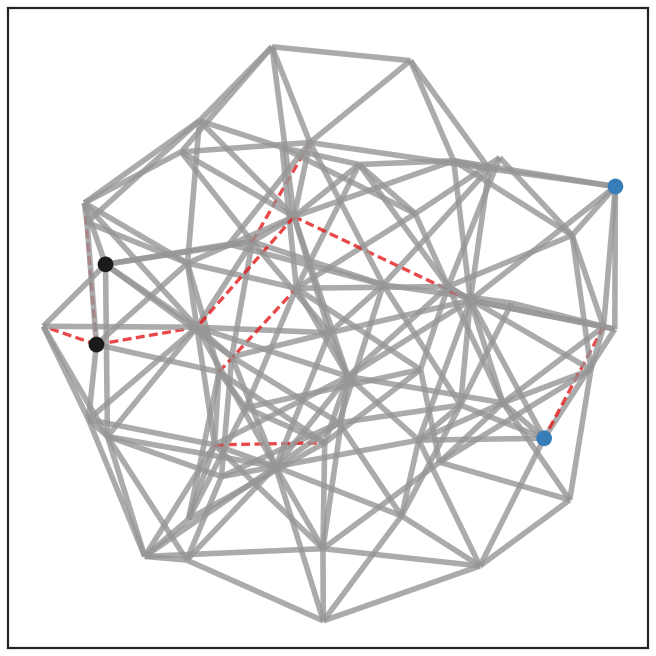

23


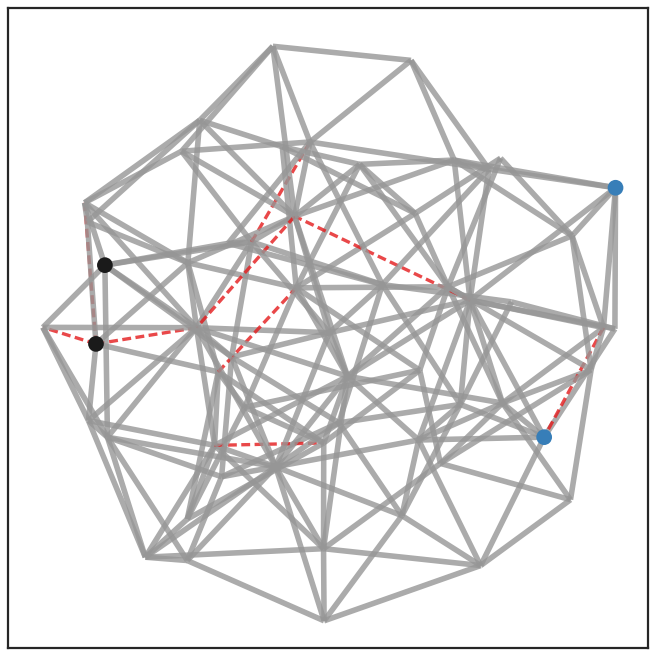

24


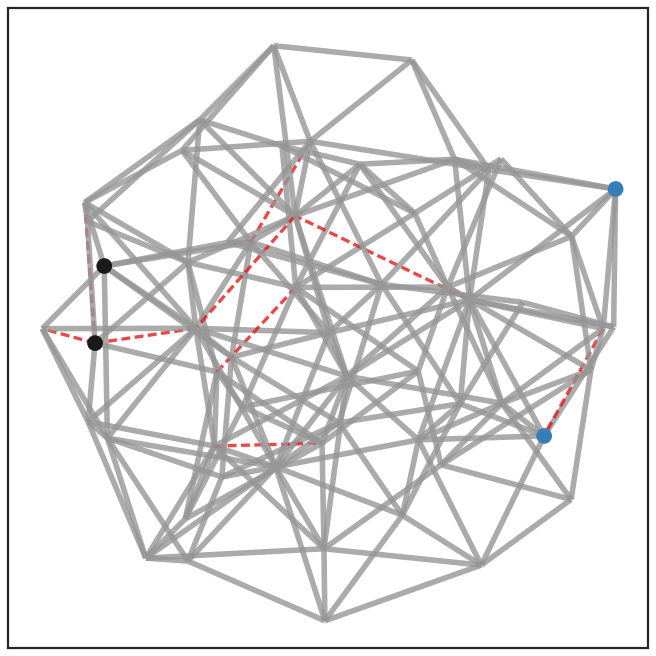

25


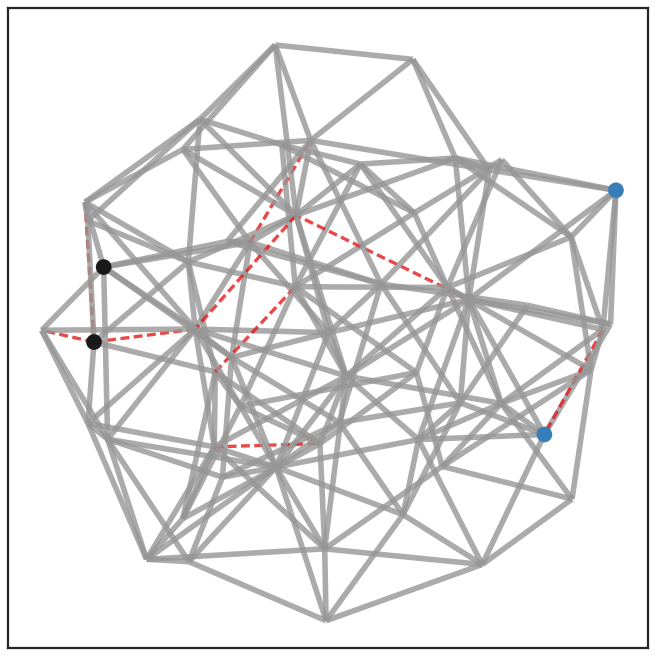

26


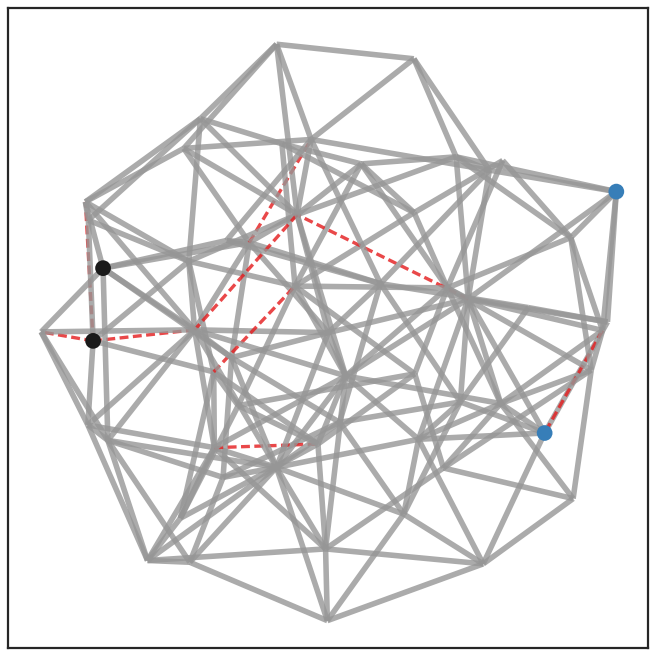

27


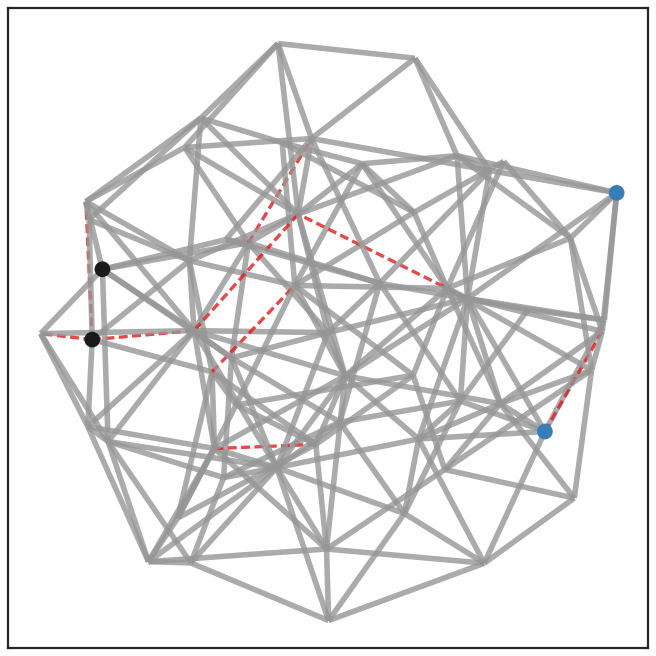

28


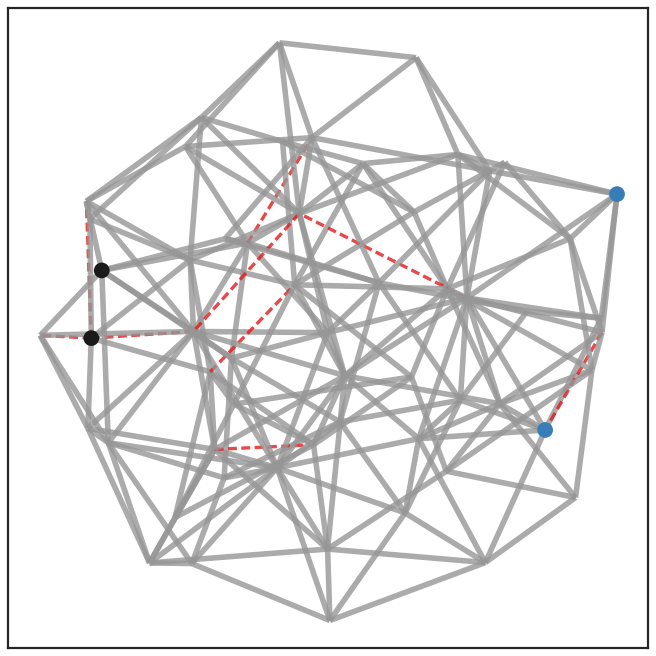

29


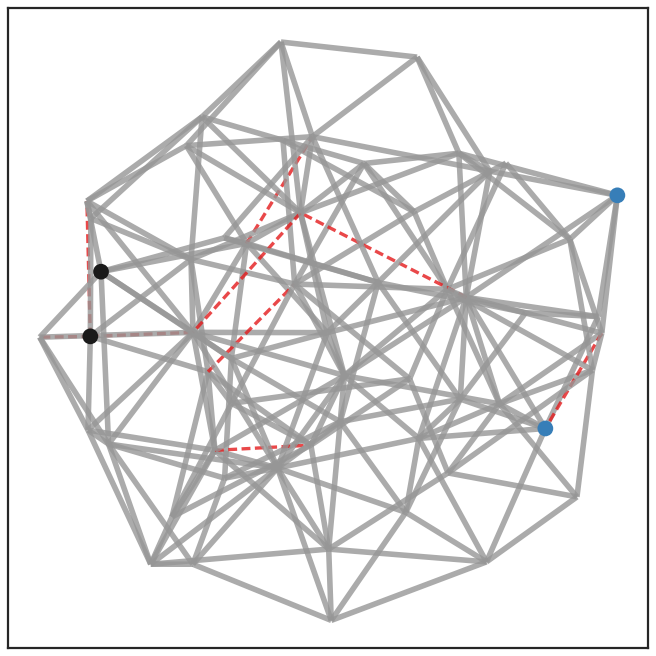

30


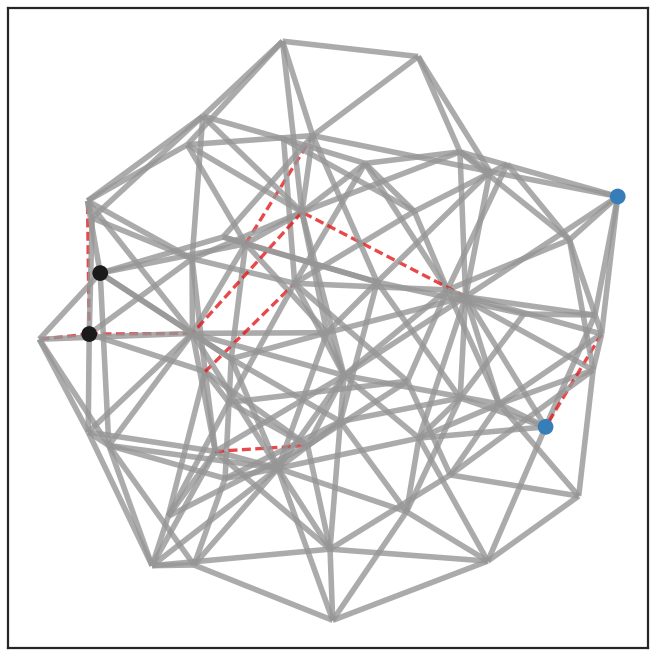

31


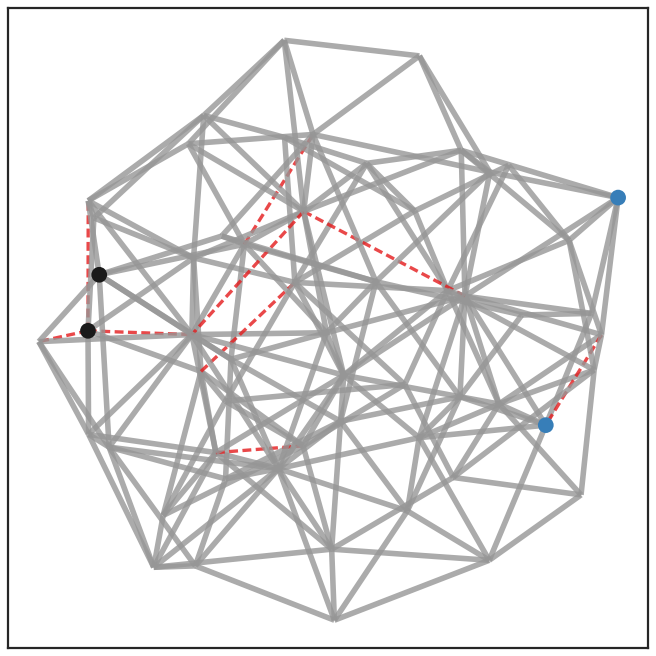

32


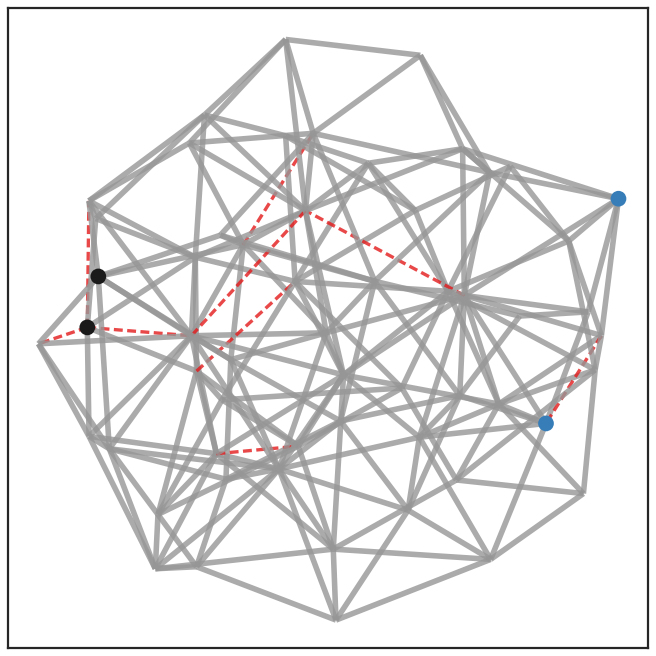

33


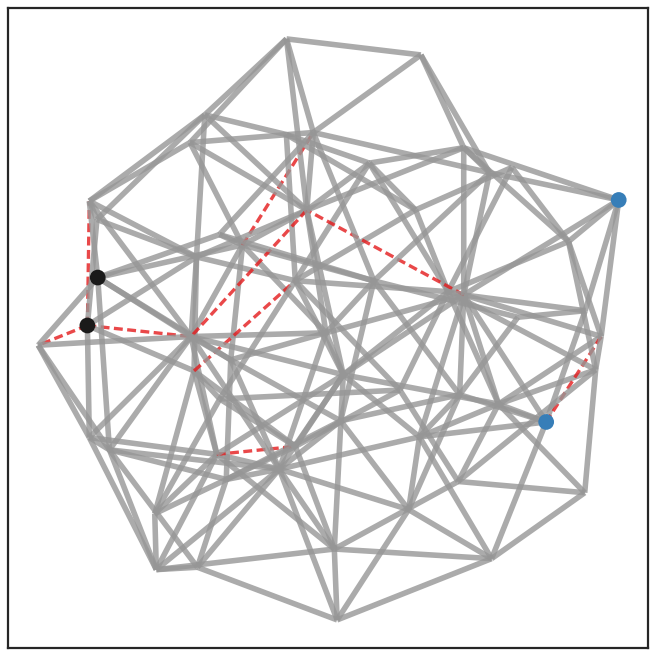

34


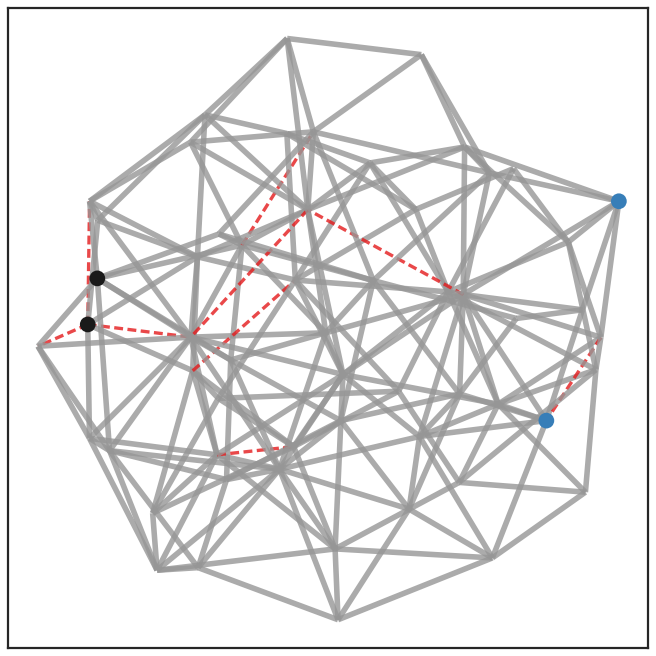

35


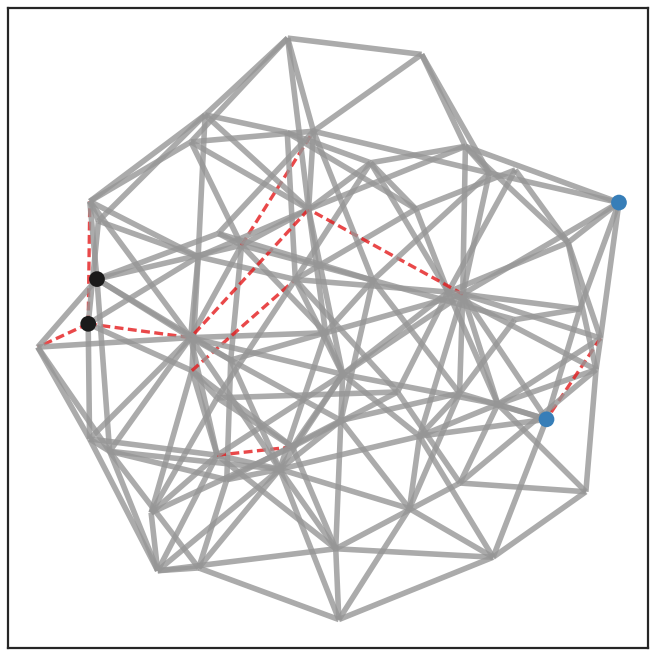

36


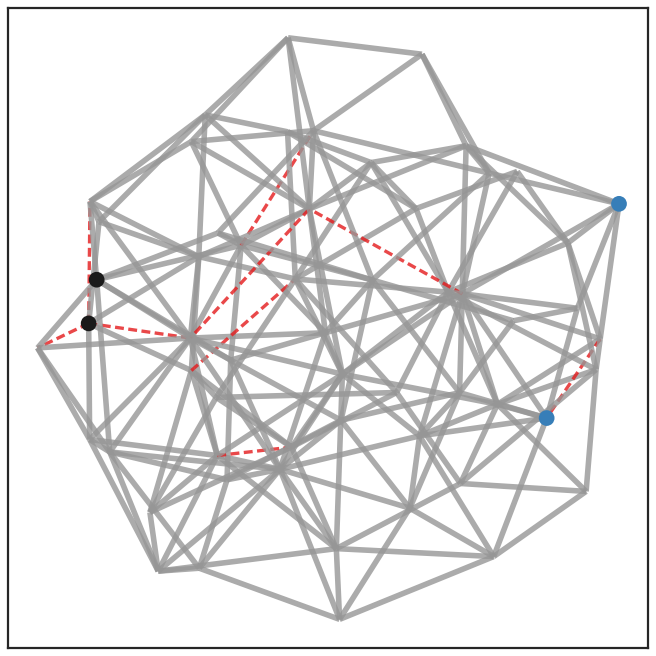

37


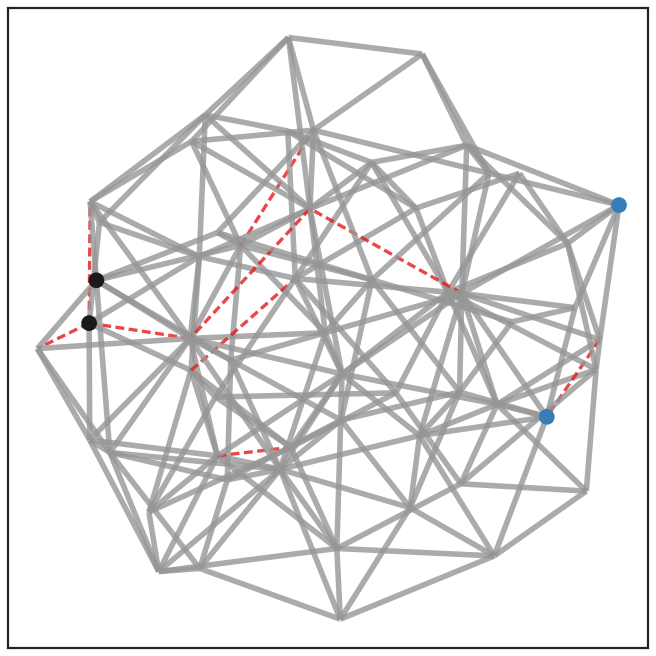

38


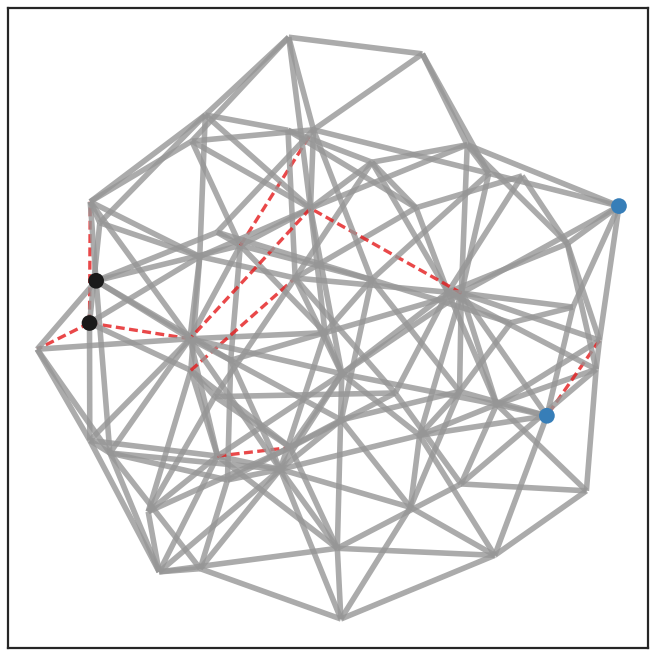

39


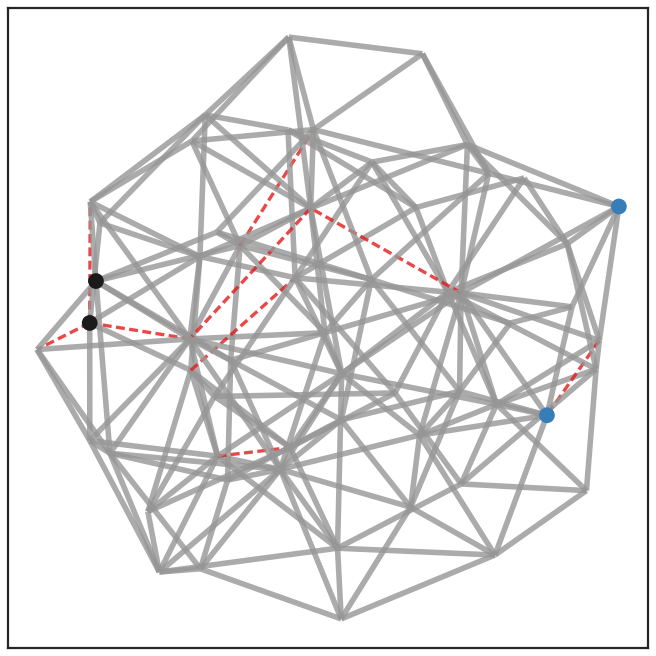

In [25]:
K = result['K']
# K = K_init

tuner.solver.setIntStrengths(K)

t = 0

# mag = 0.3
mag = 1.0
nsteps = 20
alpha_list = np.concatenate([np.linspace(0, mag, nsteps), np.linspace(mag, 0, nsteps)])

Gamma = np.zeros([DIM, DIM], float)
# Gamma = np.array([[1.0, 0.0], [0.0, 1.0]])

os.system("rm figs/fig*.png")

energy = []

for i, alpha in enumerate(alpha_list):
    print i
        
    tuner.solver.setAmplitude(alpha)
    (disp, strain_tensor) = tuner.solver.solveDOF()
    energy.append(tuner.solver.solveEnergy(disp[t], t))

        
    nplot.frame(nw, disp[t], Gamma, K * nw.eq_length, pert[t], meas[t],
          "figs/fig_{:04d}.png".format(i), boxsize=0.5, padding=0.05, save=True, show_removed=True)

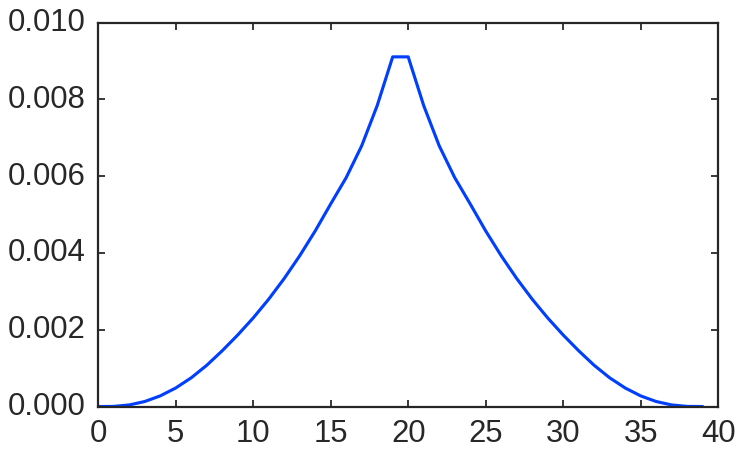

In [26]:
fig, ax = plt.subplots(figsize=(10,6))
ax.plot(range(len(alpha_list)), energy)
plt.show()

# nplot.createGIF("figs/*.png", "figs/two_resp0.gif")
nplot.createGIF("figs/*.png", "figs/test.gif")

In [301]:
nplot.createGIF("figs/*.png", "figs/two_resp1.gif")